In [2]:
import pandas as pd
import numpy as np
from bioreactor.plotting import *
from bioreactor.use_colors import *
from bioreactor.annotation import *
from bioreactor.ssgsea import *
from bioreactor.gsea import *
from bioreactor.expression import  *
from bioreactor.pathway_scoring import *
from bioreactor.survival import * 
from bioreactor.graphs import *

from bioreactor.utils import *
from bioreactor.mutations import *
from bioreactor.clustering import *

from mldeconv.cells_plotting import *
from mldeconv.data_loading import *

from typing import Tuple, List, Optional
import warnings
from tqdm.notebook import tqdm
from scipy.stats import spearmanr
import scipy

from collections import defaultdict
from scipy.spatial.distance import pdist, squareform
import itertools as it
import os

In [3]:
import warnings
warnings.filterwarnings('ignore')

In [7]:
def get_gspread(table, sheet, index_col=0, path_to_json=None): 
    """
    Access Google Sheets via python
    
    :param path_to_json: absolute path to JSON containing creditials for Google API
    :param table: Annotation calculated, for instance
    :param sheet: Blood, for instance
    :param index_col: column number
    :return: pandas DataFrame
    """
    from oauth2client.service_account import ServiceAccountCredentials
    import gspread
    
    if path_to_json == None:
        path_to_json = '/uftp/Blood/google_secret.json'

    credentials = ServiceAccountCredentials.from_json_keyfile_name(
        path_to_json)  # Your json file here
    gc = gspread.authorize(credentials)

    # open table
    wks = gc.open(table)
    # select sheet
    sheet = wks.worksheet(sheet)
    data = pd.DataFrame(sheet.get_all_records())
    data = data.set_index(data.columns[index_col])
    return data

In [13]:
import seaborn as sns
sns.set_style("white")

In [14]:
cells_p['Epithelium'] = '#DFD3CF'
cells_p['Pericytes_and_smooth_muscle'] = '#CC7A00'
cells_p['Glial_cells'] = '#995B00'

# Signature validation: single cell data

In [15]:
import scanpy as sc

In [16]:
sc.logging.print_header()

scanpy==1.9.1 anndata==0.10.6 umap==0.5.5 numpy==1.22.4 scipy==1.8.1 pandas==1.5.3 scikit-learn==1.1.1 statsmodels==0.14.1 python-igraph==0.11.4 pynndescent==0.5.12


scanpy==1.10.0 is incompatible with mldeconv==0.1.89

In [17]:
def get_expression_dataframe(adata):
    adata.X = scipy.sparse.csc_matrix(adata.X)
    expr_df = pd.DataFrame.sparse.from_spmatrix(adata.X, index=adata.obs_names, columns=adata.var_names).T
    row_sums = expr_df.sum(axis=1)
    row_sums = row_sums[row_sums > 0]
    expr_df = expr_df.loc[row_sums.index]
    return expr_df

In [18]:
def calculate_and_plot_ssgsea(adata, expr_df, geneset_of_interest, signature_name, celltype_col='Cell_type', y_max=None, y_min=None, palette=cells_p):
    cprocesses = ssgsea_formula(expr_df, gmt_genes_alt_names(geneset_of_interest, expr_df.index, verbose=False), rank_method='average').T
    cprocesses_sc = median_scale(cprocesses)
    cprocesses["Cell_types"] = adata.obs[celltype_col].tolist()
    cprocesses["Cell_name"] = cprocesses_sc.index
    cprocesses_sc["Cell_types"] = adata.obs[celltype_col].tolist()
    cprocesses_sc["Cell_name"] = cprocesses_sc.index
    ctypes_median = pd.Series(data="NA", index=set(adata.obs[celltype_col].tolist()))   
    for type_name in cprocesses["Cell_types"]:
        ctypes_median[type_name] = cprocesses.loc[cprocesses['Cell_types'] == type_name][signature_name].median()
    df_median = ctypes_median.sort_values(ascending = False)
    ax = boxplot_with_pvalue(cprocesses_sc[signature_name], cprocesses_sc["Cell_types"], order = df_median.index, swarm=False,
                       figsize = [10, 6], y_max=y_max, y_min=y_min, palette=palette)
    ax.set_xticklabels(ax.get_xticklabels(),rotation=90)
    return cprocesses, cprocesses_sc, df_median, ax

In [19]:
def calculate_pvalues(cprocesses, cprocesses_new, populations, signature_name, signature_name_new, dataset):
    from scipy.stats import mannwhitneyu
    pvalues_greater = pd.Series(index=populations)
    pvalues_less = pd.Series(index=populations)
    for i in populations:
            samples_g1 = cprocesses_new[cprocesses_new.Cell_types == i].index
            samples_g2 = cprocesses[cprocesses.Cell_types == i].index
            try:
                if len(samples_g1) and len(samples_g2):
                    pv_g = mannwhitneyu(cprocesses_new.loc[samples_g1][signature_name_new], cprocesses.loc[samples_g2][signature_name], alternative='greater').pvalue
                    pv_l = mannwhitneyu(cprocesses_new.loc[samples_g1][signature_name_new], cprocesses.loc[samples_g2][signature_name], alternative='less').pvalue
                else:
                    pv_g = 1
                    pv_l = 1
            except ValueError:
                pv_g = 1
                pv_l = 1
            pvalues_greater[i] = pv_g
            pvalues_less[i] = pv_l
    pvalues_greater = pvalues_greater*(len(populations)-1)
    for i in pvalues_greater.index:
        if pvalues_greater[i]>1:
            pvalues_greater[i]=1
    pvalues_less = pvalues_less*(len(populations)-1)
    for i in pvalues_less.index:
        if pvalues_less[i]>1:
            pvalues_less[i]=1
    pvalues = pd.DataFrame()
    pvalues[f'{signature_name}_{dataset}'] = pvalues_less
    pvalues[f'{signature_name_new}_{dataset}'] = pvalues_greater
    return pvalues

In [20]:
def process_scrna_dataset(adata, geneset_of_interest, signature_name, geneset_of_interest_new, signature_name_new, dataset,
                          celltype_col='Cell_type', y_max=None, y_min=None, palette=cells_p, save_orig=None, save_tuned=None):
    expr_df = get_expression_dataframe(adata)
    cprocesses, cprocesses_sc, df_median, ax = calculate_and_plot_ssgsea(adata, expr_df, geneset_of_interest, signature_name, celltype_col=celltype_col, y_max=y_max, y_min=y_min, palette=palette)
    cprocesses_new, cprocesses_sc_new, df_median_new, ax1 = calculate_and_plot_ssgsea(adata, expr_df, geneset_of_interest_new, signature_name_new, celltype_col=celltype_col, y_max=y_max, y_min=y_min, palette=palette)
    sc.pl.umap(adata, color=[celltype_col])
    adata.obs[signature_name] = cprocesses_sc[signature_name]
    sc.pl.umap(adata, color=[signature_name], title='Macrophage signature, Bindea et al.', save=save_orig)
    adata.obs[signature_name_new] = cprocesses_sc_new[signature_name_new]
    sc.pl.umap(adata, color=[signature_name_new], title='Macrophage signature, tuned', save=save_tuned)
    try:
        sc.pl.umap(adata, color=np.intersect1d(signature_of_interest, expr_df.index).tolist())
    except:
        print('UMAP for signature genes can not be plotted')
    try:
        sc.pl.umap(adata, color=np.intersect1d(signature_of_interest_new, expr_df.index).tolist())
    except:
        print('UMAP for refined signature genes can not be plotted')
    scs = pd.DataFrame(index = df_median_new.index)
    scs[f'{signature_name}_{dataset}'] = df_median
    scs[f'{signature_name_new}_{dataset}'] = df_median_new
    pvalues = calculate_pvalues(cprocesses, cprocesses_new, scs.index, signature_name, signature_name_new, dataset)
    return ax, ax1, scs, pvalues

## Definition of custom signature (once again, same as above)

In [21]:
signature_of_interest = '''MARCO	CXCL5	SCG5	SULT1C2	MSR1	CTSK	PTGDS	COLEC12	GPC4	PCOLCE2	CHIT1	ANOS1	CLEC5A	ME1	DNASE2B	CCL7	FN1	CD163	GM2A	SCARB2	BCAT1	RAI14	COL8A2	APOE	CHI3L1	ATG7	CD84	FDX1	MS4A4A	SGMS1	EMP1	CYBB	CD68'''.split('\t')

#add here a custon signature name
signature_name = 'Macrophages'
geneset_of_interest = {signature_name:GeneSet(signature_name, '', signature_of_interest)}

In [22]:
signature_of_interest_new = [
'MARCO',
# 'CXCL5', low expression in M2/TAMs, expression in some cancer lines, low correlation with deconvolution and with other signature genes (TCGA), no expression in single cell macrophages
# 'SCG5',
# 'SULT1C2',
 'MSR1',
# 'CTSK', fibroblasts
# 'PTGDS', pDC, fibroblasts
# 'COLEC12', fibroblasts
# 'GPC4', fibroblasts, tumor
# 'PCOLCE2', fibroblasts
# 'CHIT1', low correlation with other genes (TCGA)
# 'ANOS1',
 'CLEC5A',
# 'ME1', fibroblasts, tumor, MAIT
# 'DNASE2B', low expression, no correlation with deconvolution
 'CCL7',
# 'FN1', fibroblasts
 'CD163',
# 'GM2A', not specific
# 'SCARB2', not specific
# 'BCAT1', not specific
# 'RAI14', fibroblasts, endothelium, tumor
# 'COL8A2', fibroblasts
# 'APOE', fibroblasts
# 'CHI3L1', neutrophils
# 'ATG7', not specific
# 'CD84', not specific
# 'FDX1', not specific
 'MS4A4A',
# 'SGMS1', not specific
# 'EMP1', fibroblasts, endothelium, tumor
# 'CYBB', DC, B cells
 'CD68',
    'CSF1R', 
    'SIGLEC1', 
    'C1QA', 
    'C1QC', 
    'VSIG4'

]
#actually many deleted genes have problems with expression in cancer lines, low TCGA correlations and single cell. I can write it thoroughly if we need it

#add here a custon signature name
signature_name_new = 'Macrophages_new'
geneset_of_interest_new = {signature_name_new:GeneSet(signature_name_new, '', signature_of_interest_new)}

## read annotation and expressions

https://docs.google.com/spreadsheets/d/1OPG6o5rq8lOnP1QZm8gSmgLPjq3Vz-gM6o3i8wzkBbQ/edit#gid=0 - here we have a full list of single cell data, pick anything suitable for your signature. Replace path in cell below with the path you see in H5ad column

In [23]:
scs = {}
pvalues = {}
celltype_col = 'Cell_type'

### BG NSCLC dataset

In [93]:
#NSCLC
adata = sc.read('/uftp/single_cell/annotations/BG_Lab_datasets/210223_NovaB_RNA_10X/RS0154_s3_NSCLC/query_RS0154_s3_NSCLC.h5ad')
dataset = 'BG'

In [94]:
predict = pd.read_csv('azimuth_pred_RS0154_s3_NSCLC.tsv', sep='\t', index_col=0)
adata.obs['predicted.ann_level_3'] = predict['predicted.ann_level_3']
adata.obs['predicted.ann_finest_level'] = predict['predicted.ann_finest_level']
adata.obs['Cell_type'] = adata.obs['predicted.ann_level_3'].astype(str)
cells = adata.obs[(adata.obs['predicted.ann_level_3'].isin(['Multiciliated lineage', 'AT2', 'AT1', 'Rare']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Epithelium'
cells = adata.obs[(adata.obs['predicted.ann_level_3'].isin(['B cell lineage']))].index
adata.obs.loc[cells, 'Cell_type'] = 'B_cells'
cells = adata.obs[(adata.obs['predicted.ann_level_3'].isin(['Mast cells']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Mast_cells'
cells = adata.obs[(adata.obs['predicted.ann_level_3'].isin(['T cell lineage']))].index
adata.obs.loc[cells, 'Cell_type'] = 'T_cells'
cells = adata.obs[(adata.obs['predicted.ann_level_3'].isin(['Dendritic cells']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Dendritic_cells'
cells = adata.obs[(adata.obs['predicted.ann_level_3'].isin(['Monocytes']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Monocytes'
cells = adata.obs[(adata.obs['predicted.ann_level_3'].isin(['Innate lymphoid cell NK']))].index
adata.obs.loc[cells, 'Cell_type'] = 'NK_cells'
cells = adata.obs[(adata.obs['predicted.ann_level_3'].isin(['Fibroblasts', 'Myofibroblasts']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Fibroblasts'
cells = adata.obs[(adata.obs['predicted.ann_level_3'].isin(['EC capillary', 'EC arterial', 'EC venous', 'Lymphatic EC mature', 'Lymphatic EC differentiating']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Endothelium'
cells = adata.obs[(adata.obs['predicted.ann_finest_level'].isin(['Pericytes', 'Smooth muscle']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Pericytes_and_smooth_muscle'
cells = adata.obs[(adata.obs['predicted.ann_level_3'].isin(['Macrophages']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Macrophages'
adata.obs.Cell_type.value_counts()

T_cells                        5436
B_cells                        2895
Endothelium                     768
Epithelium                      511
Monocytes                       314
Fibroblasts                     256
Dendritic_cells                 225
Mast_cells                      200
NK_cells                        139
Pericytes_and_smooth_muscle     115
Macrophages                     106
Name: Cell_type, dtype: int64

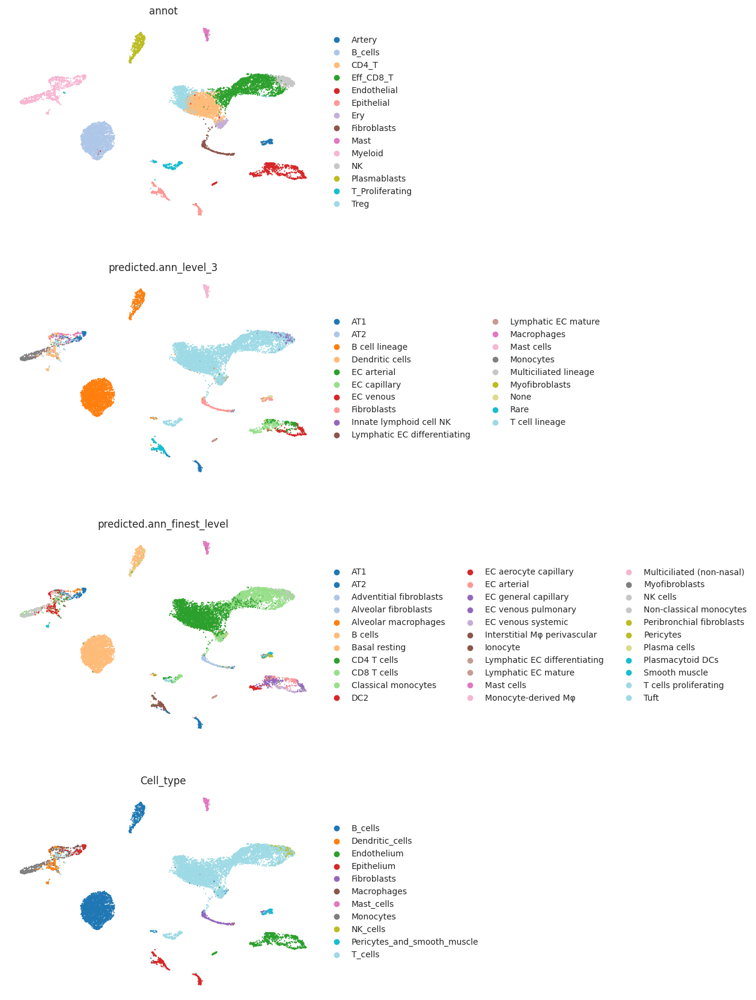

In [95]:
sc.pl.umap(adata, color=['annot', 'predicted.ann_level_3', 'predicted.ann_finest_level', 'Cell_type'], palette='tab20', frameon=False, ncols=1)

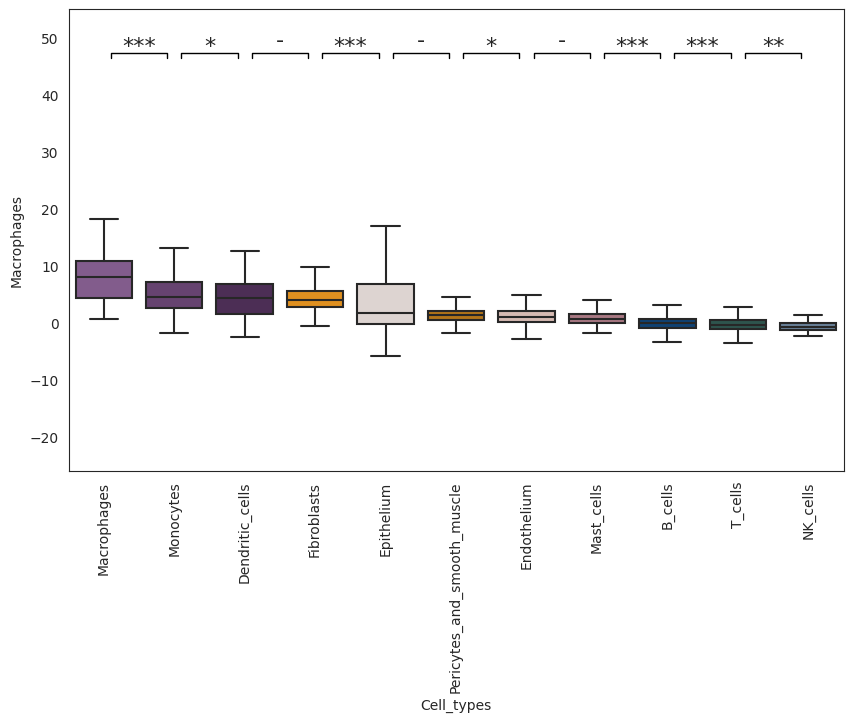

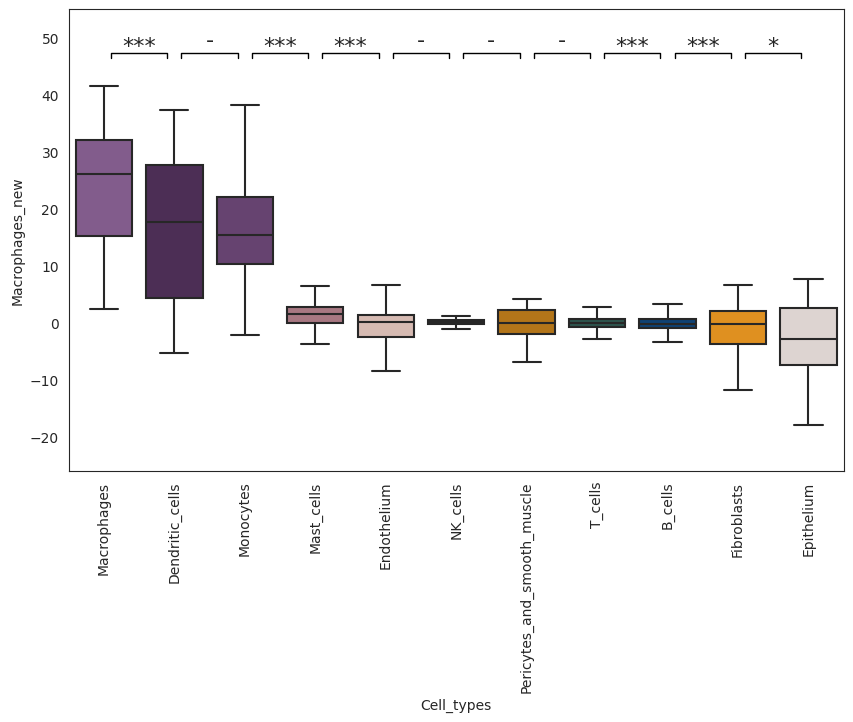

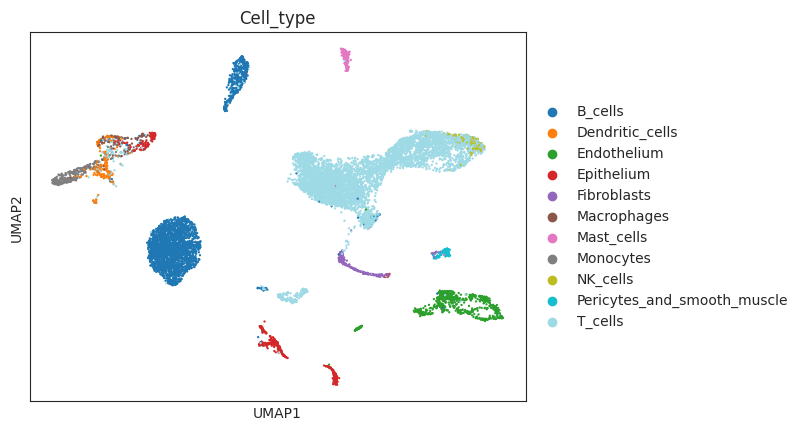

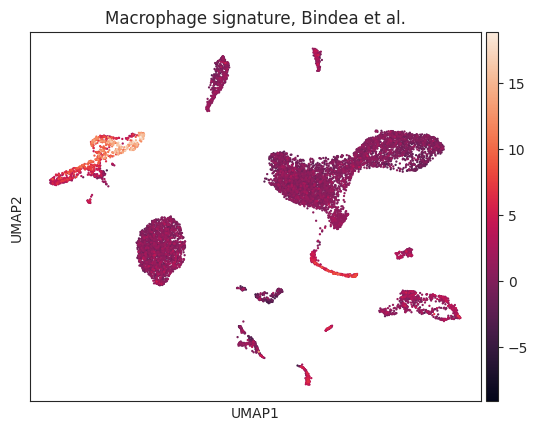

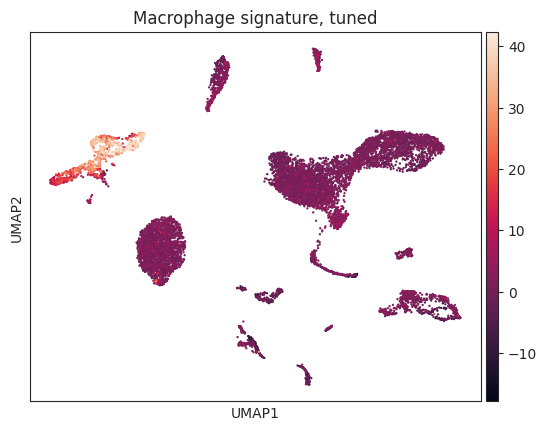

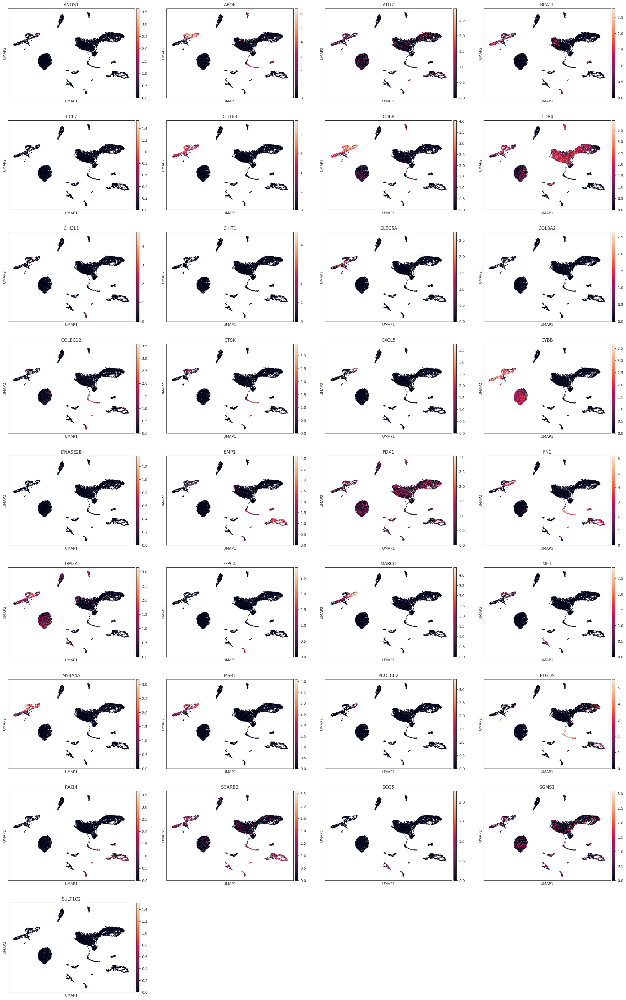

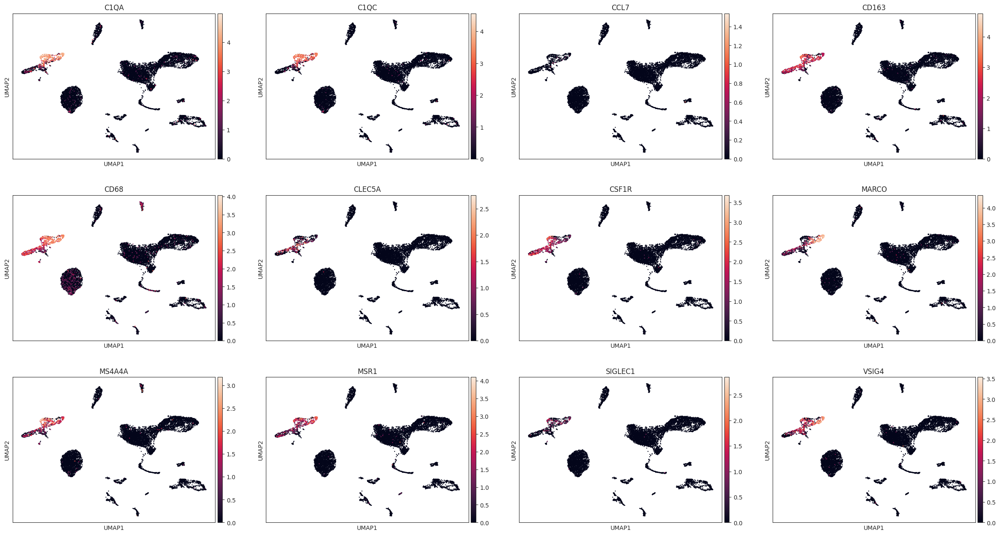

In [98]:
ax, ax1, scs[dataset], pvalues[dataset] = process_scrna_dataset(adata, geneset_of_interest, signature_name, geneset_of_interest_new, signature_name_new, dataset,
                          celltype_col='Cell_type', y_max=43, y_min=-17, palette=cells_p, save_orig=None, save_tuned=None)

### Nieto et al Tumor Immune Atlas

This dataset is too large to process, so I took 1/10 of it saving proportions of cell types and individual donors

In [ ]:
adata = sc.read('/uftp/single_cell/annotations/Public_datasets/Atlas_Reference/PMID_34548323_Nieto_et_al_TumorImmuneAtlas/TumorImmuneAtlas.h5ad/')
a = []
adata1 = []
for i in adata.obs.cell_type.unique():
    for j in adata.obs.source.unique():
        a = adata[(adata.obs.cell_type==i) & (adata.obs.source==j)][:int(len(adata[(adata.obs.cell_type==i) & (adata.obs.source==j)])/10)]
        if len(a.obs.index)>0:
            adata1.append(a)
adata = adata1
adata = adata[0].concatenate(adata[1:])
#adata.write_h5ad('/uftp/users/msavchenko/data/TumorImmuneAtlas_div10.h5ad')

In [99]:
#1/10 of TumorImmuneAtlas
#adata = sc.read('/uftp/users/msavchenko/data/TumorImmuneAtlas_div10.h5ad')
dataset = 'Nieto'

In [100]:
adata.obs['Cell_type'] = 'T_cells'
cells = adata.obs[(adata.obs.cell_type.isin(['B cells', 'Plasma B cells', 'Proliferative B cells']))].index
adata.obs.loc[cells, 'Cell_type'] = 'B_cells'
cells = adata.obs[(adata.obs.cell_type.isin(['mDC', 'pDC', 'cDC']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Dendritic_cells'
cells = adata.obs[(adata.obs.cell_type.isin(['NK']))].index
adata.obs.loc[cells, 'Cell_type'] = 'NK_cells'
cells = adata.obs[(adata.obs.cell_type.isin(['Mast cells']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Mast_cells'
cells = adata.obs[(adata.obs.cell_type.isin(['Monocytes']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Monocytes'
cells = adata.obs[(adata.obs.cell_type.isin(['M2 TAMs', 'Proinflamatory TAMs', 'SPP1 TAMs', 'Proliferative monocytes and macrophages']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Macrophages'
adata.obs.Cell_type.value_counts()

T_cells            21713
B_cells             3515
Macrophages         3264
Dendritic_cells      971
NK_cells             949
Monocytes            946
Mast_cells           218
Name: Cell_type, dtype: int64

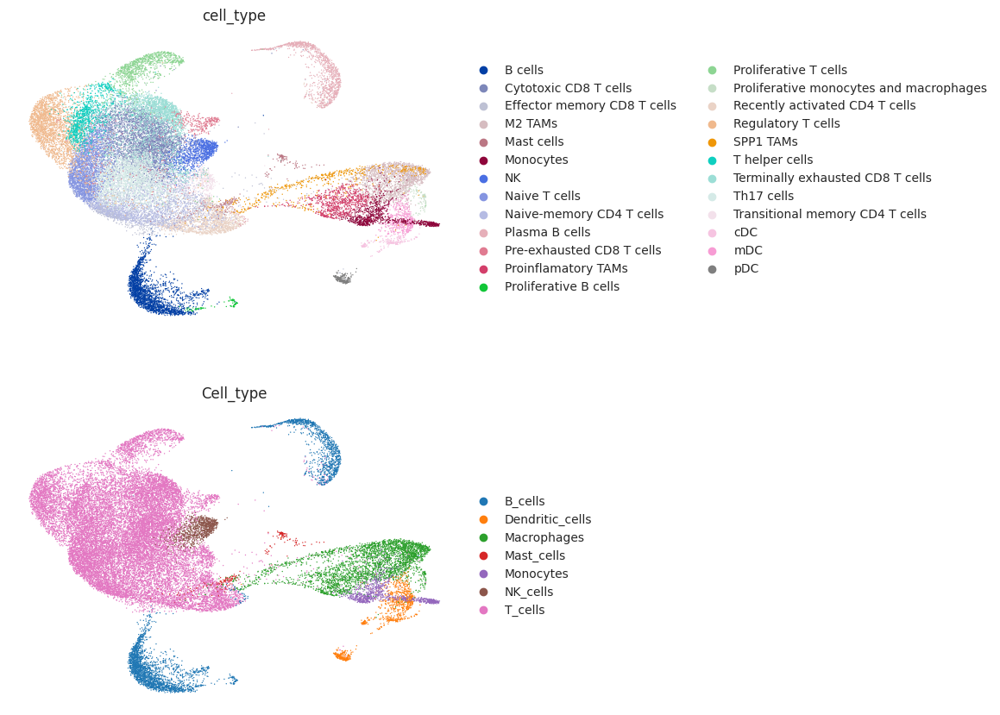

In [101]:
sc.pl.umap(adata, color=['cell_type', 'Cell_type'], frameon=False, ncols=1)

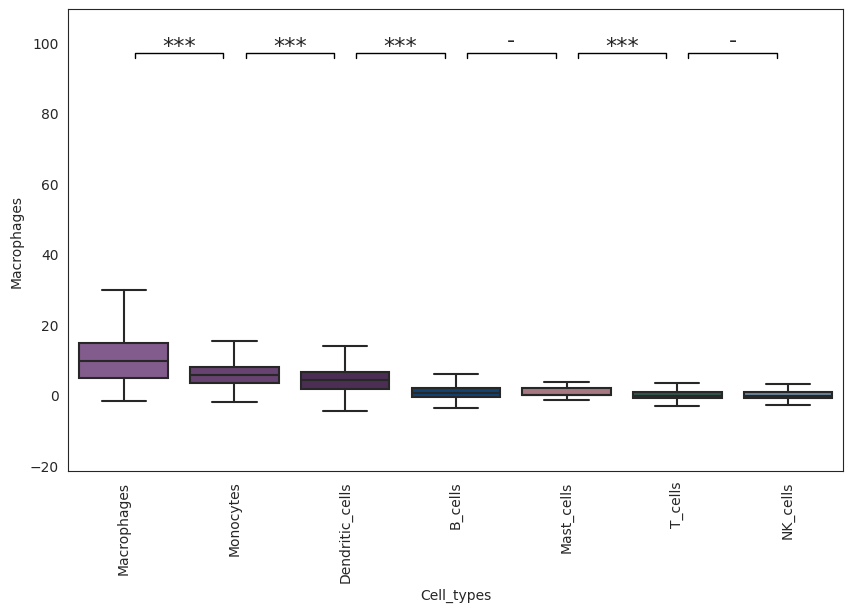

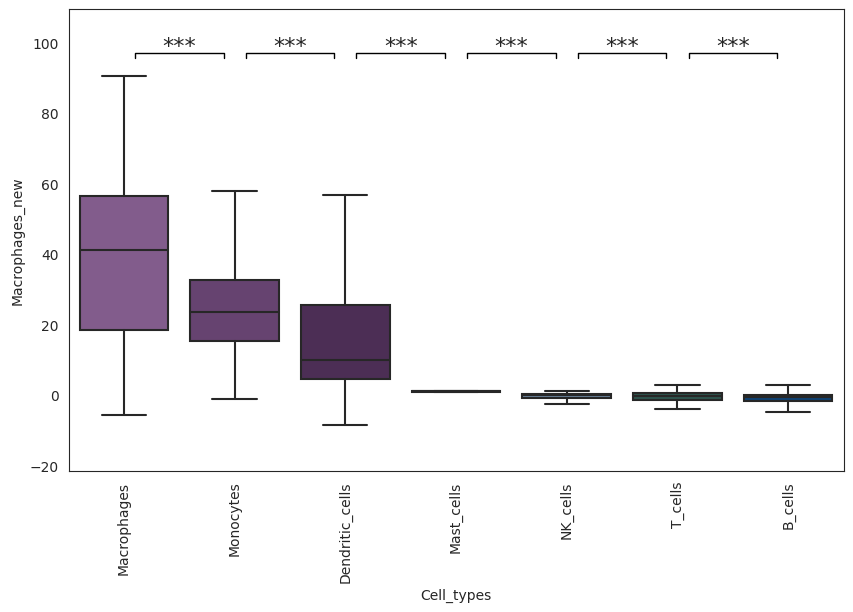

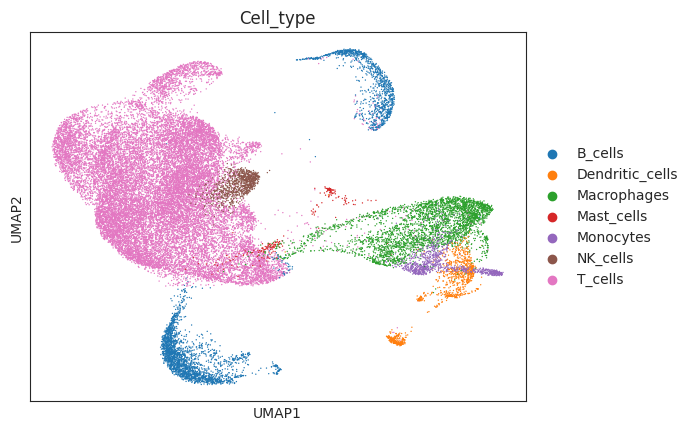

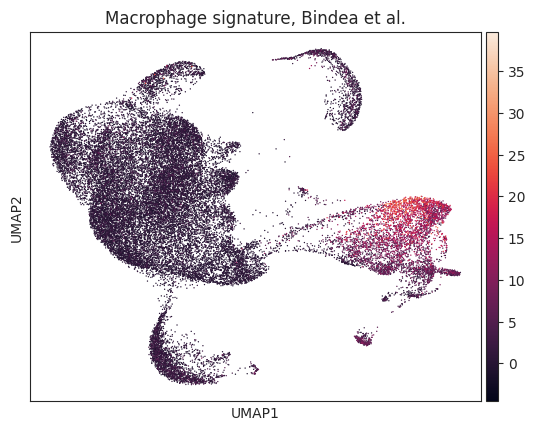

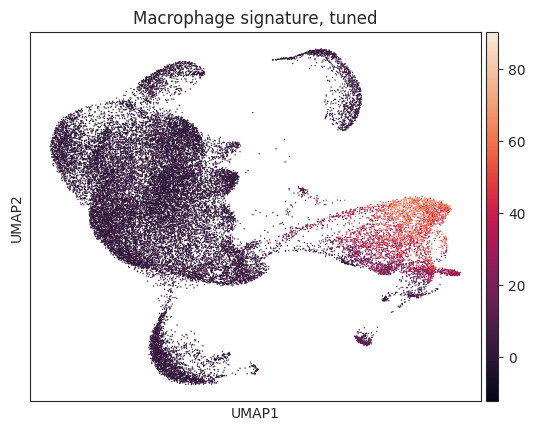

UMAP for signature genes can not be plotted
UMAP for refined signature genes can not be plotted


<Figure size 2911.2x4320 with 0 Axes>

<Figure size 2911.2x1440 with 0 Axes>

In [102]:
ax, ax1, scs[dataset], pvalues[dataset] = process_scrna_dataset(adata, geneset_of_interest, signature_name, geneset_of_interest_new, signature_name_new, dataset,
                          celltype_col='Cell_type', y_max=90, y_min=-7, palette=cells_p, save_orig=None, save_tuned=None)

In [ ]:
import matplotlib.pyplot as plt

### Puram et al HNSCC

In [103]:
#head and neck public
adata = sc.read('/uftp/single_cell/annotations/Public_datasets/Ready/PMID_29198524_Puram_et_al_Head_Neck_Cancer/PMID_29198524_Head_Neck_Cancer.h5ad')
dataset = 'Puram'

In [104]:
adata.obs['Cell_type'] = 'T_cells'
cells = adata.obs[(adata.obs['non-cancer cell type'].isin(['B cell']))].index
adata.obs.loc[cells, 'Cell_type'] = 'B_cells'
cells = adata.obs[(adata.obs['non-cancer cell type'].isin(['Dendritic']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Dendritic_cells'
cells = adata.obs[(adata.obs['non-cancer cell type'].isin(['Fibroblast', '-Fibroblast']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Fibroblasts'
cells = adata.obs[(adata.obs['non-cancer cell type'].isin(['0.0']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Epithelium'
cells = adata.obs[(adata.obs['non-cancer cell type'].isin(['Endothelial']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Endothelium'
cells = adata.obs[(adata.obs['non-cancer cell type'].isin(['myocyte']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Pericytes_and_smooth_muscle'
cells = adata.obs[(adata.obs['non-cancer cell type'].isin(['Mast']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Mast_cells'
cells = adata.obs[(adata.obs['non-cancer cell type'].isin(['Macrophage']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Macrophages'
adata.obs.Cell_type.value_counts()

Epithelium                     2539
Fibroblasts                    1440
T_cells                        1237
Endothelium                     260
B_cells                         138
Mast_cells                      120
Macrophages                      98
Dendritic_cells                  51
Pericytes_and_smooth_muscle      19
Name: Cell_type, dtype: int64

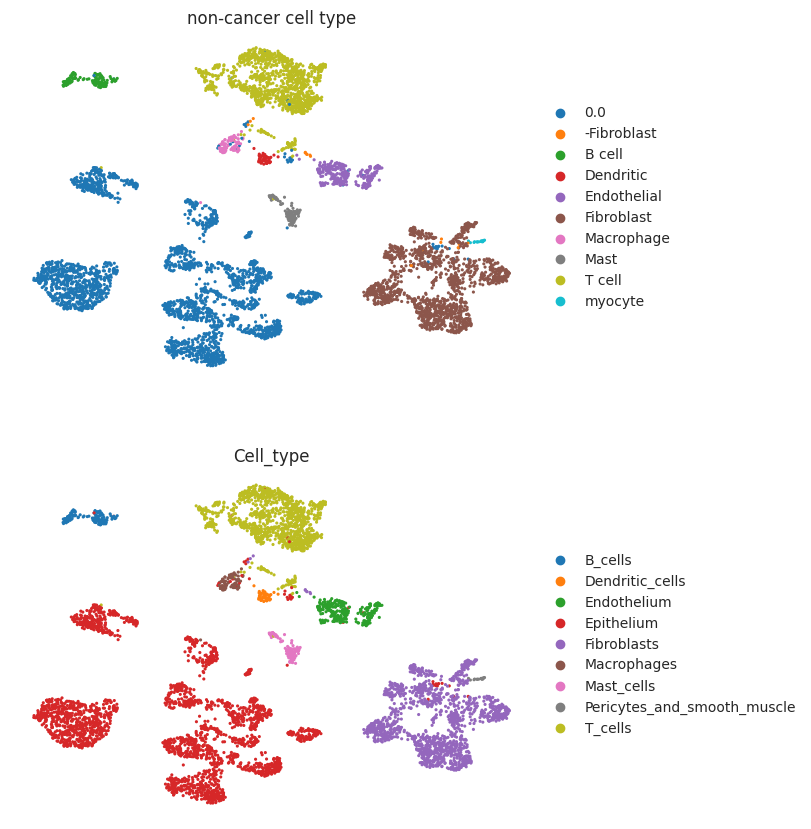

In [105]:
sc.pl.umap(adata, color=['non-cancer cell type', 'Cell_type'], frameon=False, ncols=1)

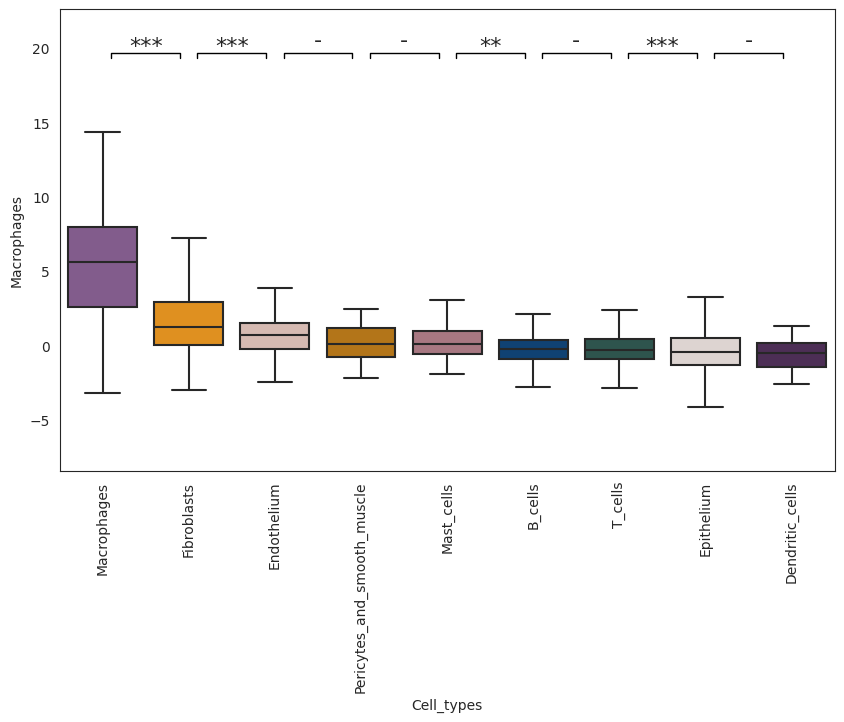

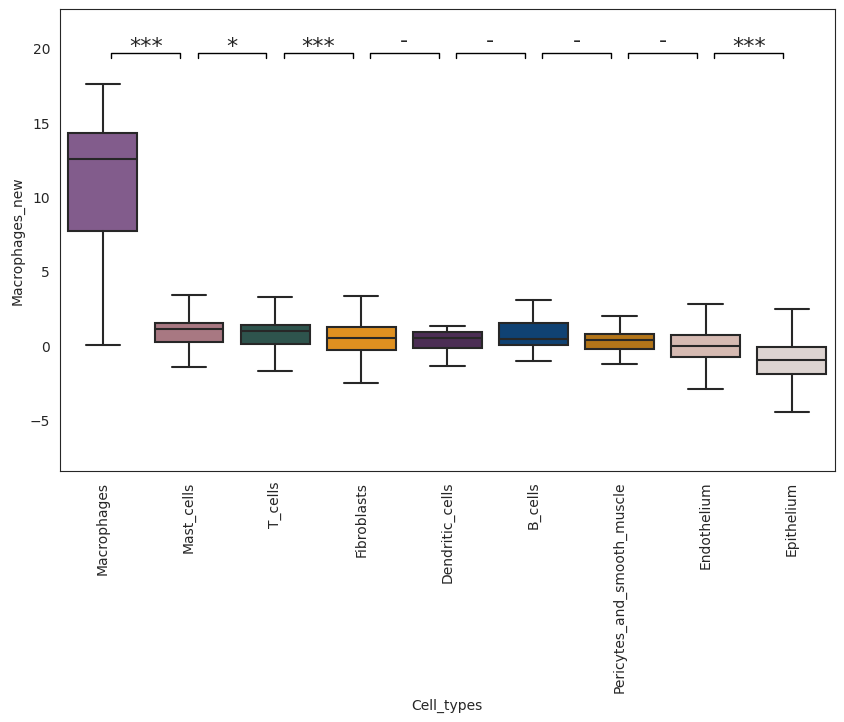

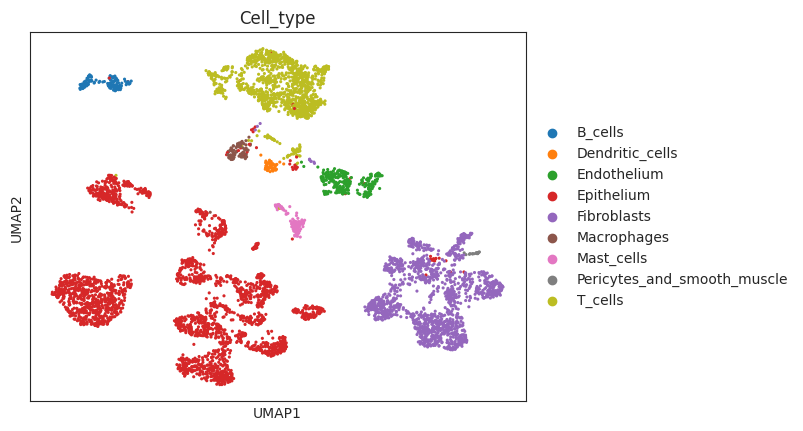

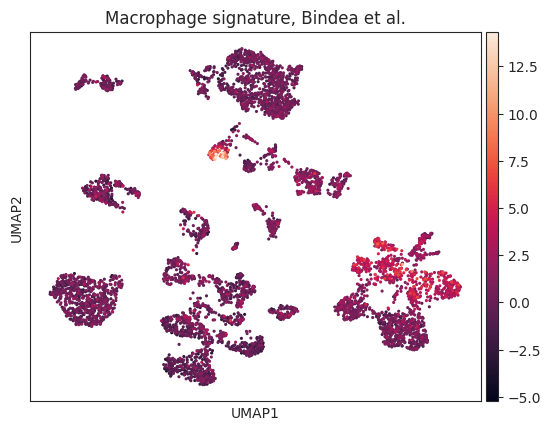

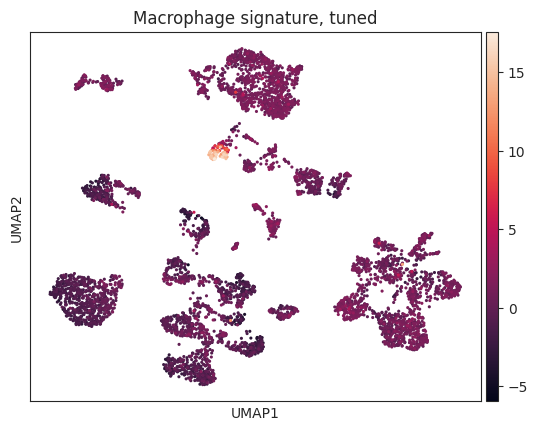

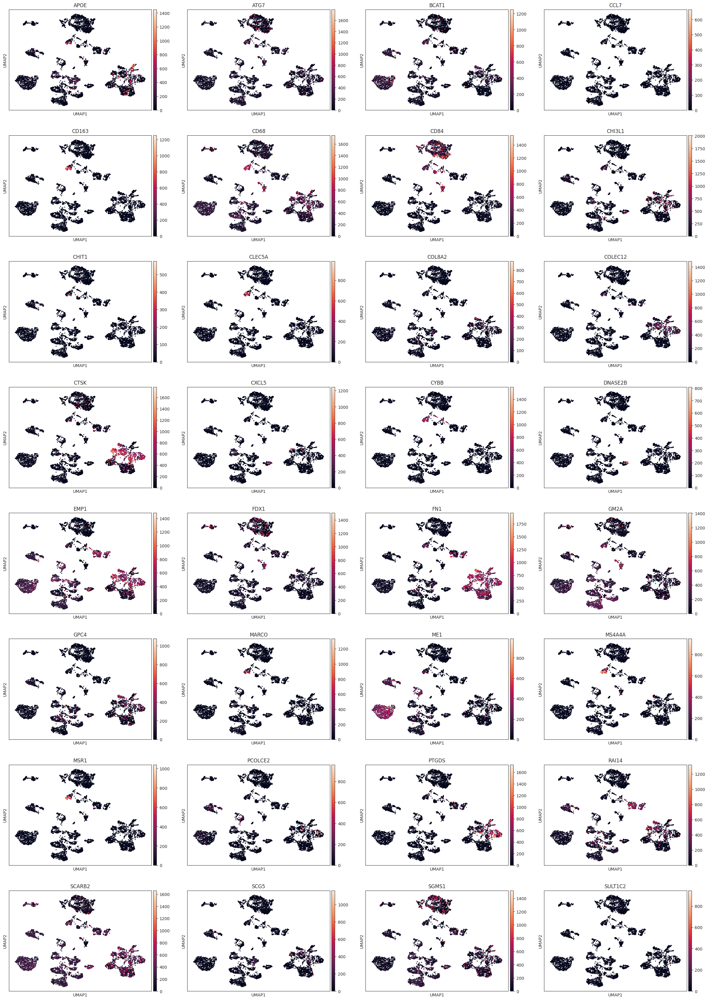

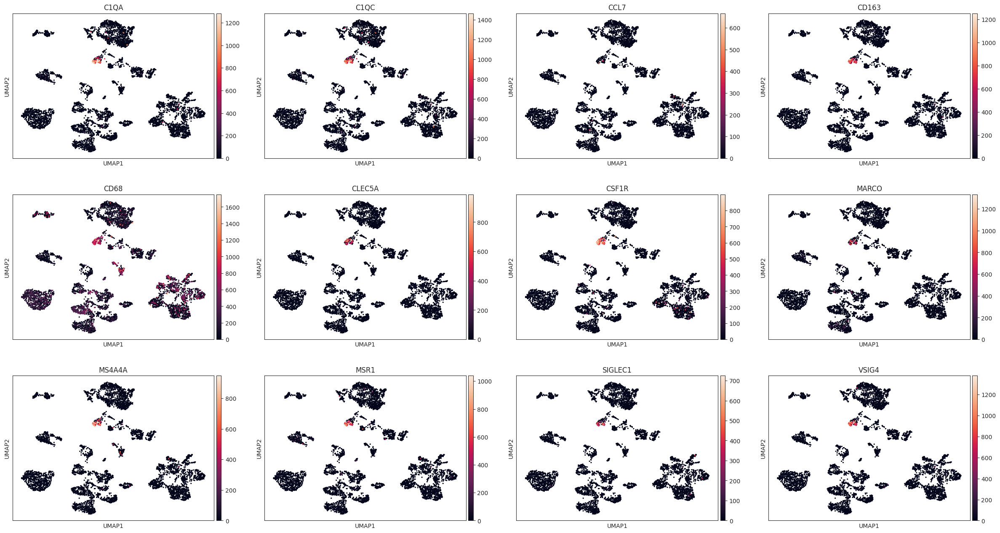

In [106]:
ax, ax1, scs[dataset], pvalues[dataset] = process_scrna_dataset(adata, geneset_of_interest, signature_name, geneset_of_interest_new, signature_name_new, dataset,
                          celltype_col='Cell_type', y_max=18, y_min=-5, palette=cells_p, save_orig=None, save_tuned=None)

### Lee et al CRC

In [107]:
# Lee CRC
adata = sc.read('/uftp/single_cell/annotations/Public_datasets/Ready/CAF_project/GSE144735_Lee_et_al_Colorectal_cancer/GSE144735.h5ad/')
dataset = 'Lee'

In [108]:
adata.obs['Cell_type'] = adata.obs['Cell_type'].astype(str)
cells = adata.obs[(adata.obs['Cell_type'].isin(['Epithelial cells']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Epithelium'
cells = adata.obs[(adata.obs['Cell_type'].isin(['B cells']))].index
adata.obs.loc[cells, 'Cell_type'] = 'B_cells'
cells = adata.obs[(adata.obs['Cell_type'].isin(['Mast cells']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Mast_cells'
cells = adata.obs[(adata.obs['Cell_type'].isin(['T cells']))].index
adata.obs.loc[cells, 'Cell_type'] = 'T_cells'
cells = adata.obs[(adata.obs['Cell_subtype'].isin(['cDC']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Dendritic_cells'
cells = adata.obs[(adata.obs['Cell_subtype'].isin(['NK cells']))].index
adata.obs.loc[cells, 'Cell_type'] = 'NK_cells'
cells = adata.obs[(adata.obs['Cell_subtype'].isin(['Enteric glial cells']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Glial_cells'
cells = adata.obs[(adata.obs['Cell_subtype'].isin(['Stromal 3', 'Stromal 2', 'Stromal 1', 'Myofibroblasts']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Fibroblasts'
cells = adata.obs[(adata.obs['Cell_subtype'].isin(['Tip-like ECs', 'Stalk-like ECs', 'Lymphatic ECs']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Endothelium'
cells = adata.obs[(adata.obs['Cell_subtype'].isin(['Pericytes', 'Smooth muscle cells']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Pericytes_and_smooth_muscle'
cells = adata.obs[(adata.obs['Cell_subtype'].isin(['Pro-inflammatory', 'Anti-inflammatory', 'SPP1+B', 'SPP1+A', 'Proliferating']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Macrophages'
cells = adata.obs[(adata.obs['Cell_type'].isin(['Myeloids']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Macrophages'
adata.obs.Cell_type.value_counts()

Epithelium                     6163
T_cells                        5487
B_cells                        4889
Fibroblasts                    4566
Macrophages                    2504
Endothelium                    1574
Pericytes_and_smooth_muscle    1027
Glial_cells                     461
NK_cells                        270
Mast_cells                      248
Dendritic_cells                 162
Name: Cell_type, dtype: int64

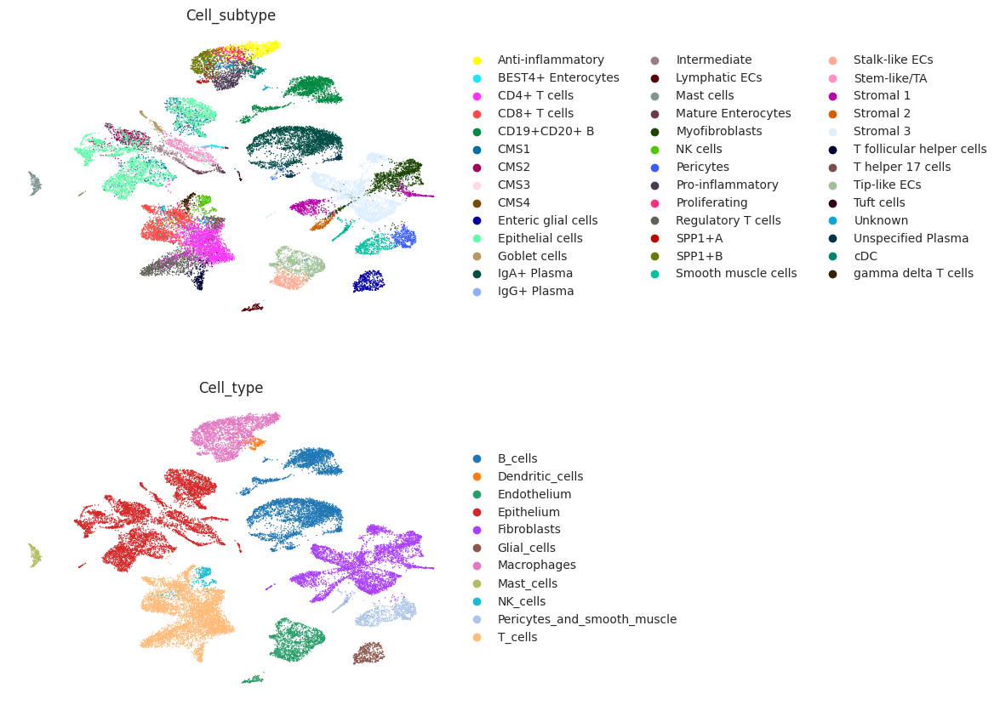

In [109]:
sc.pl.umap(adata, color=['Cell_subtype', 'Cell_type'], frameon=False, ncols=1)

Figure 4C

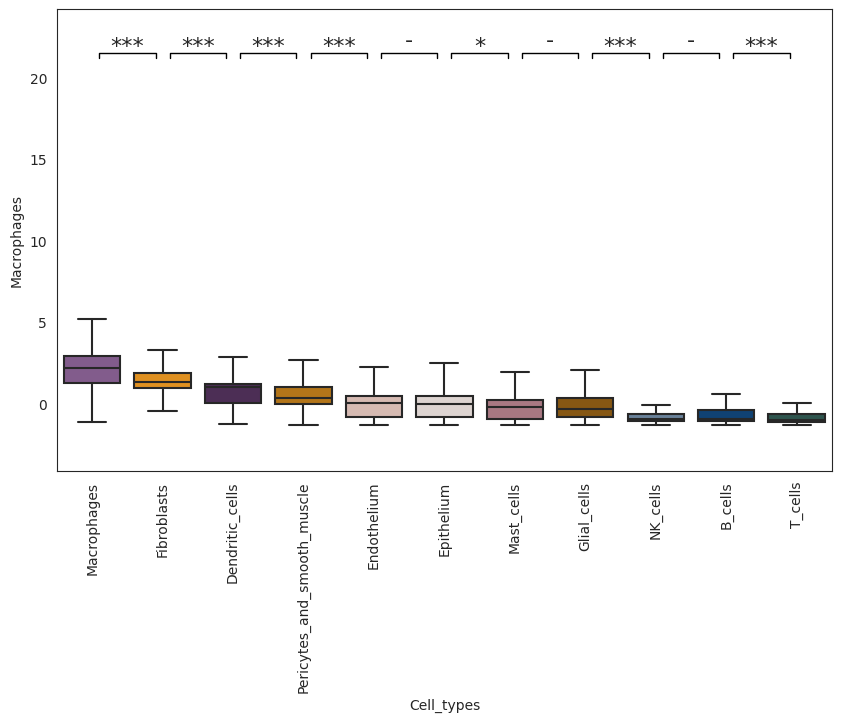

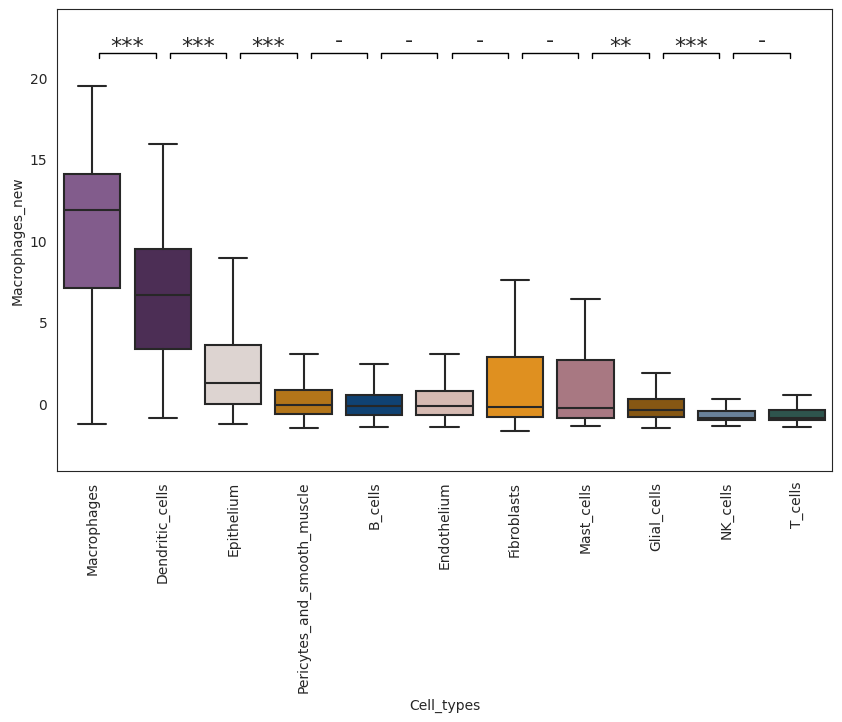

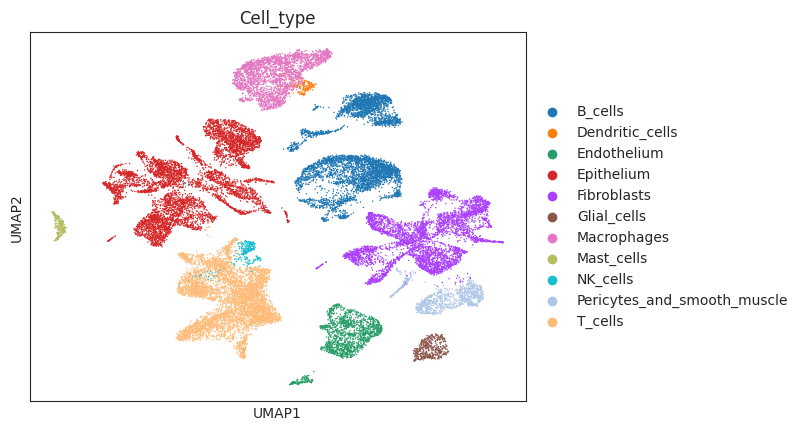

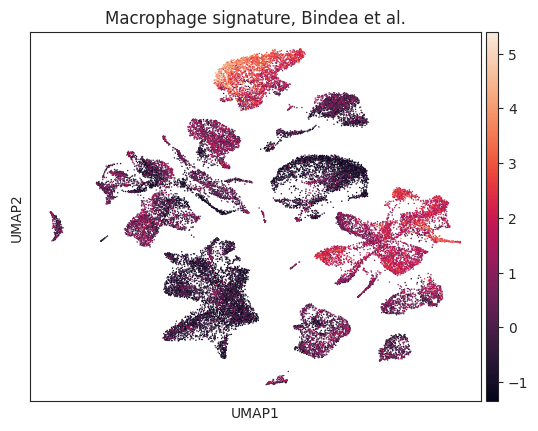

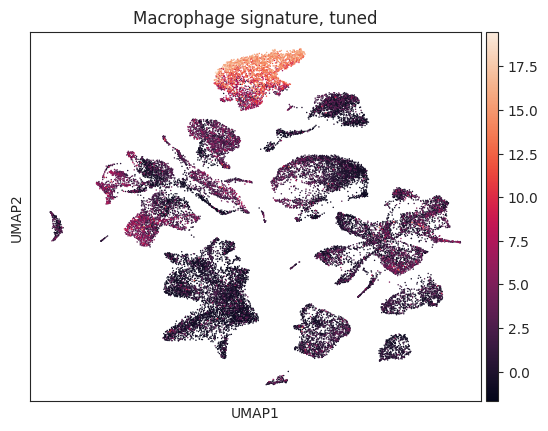

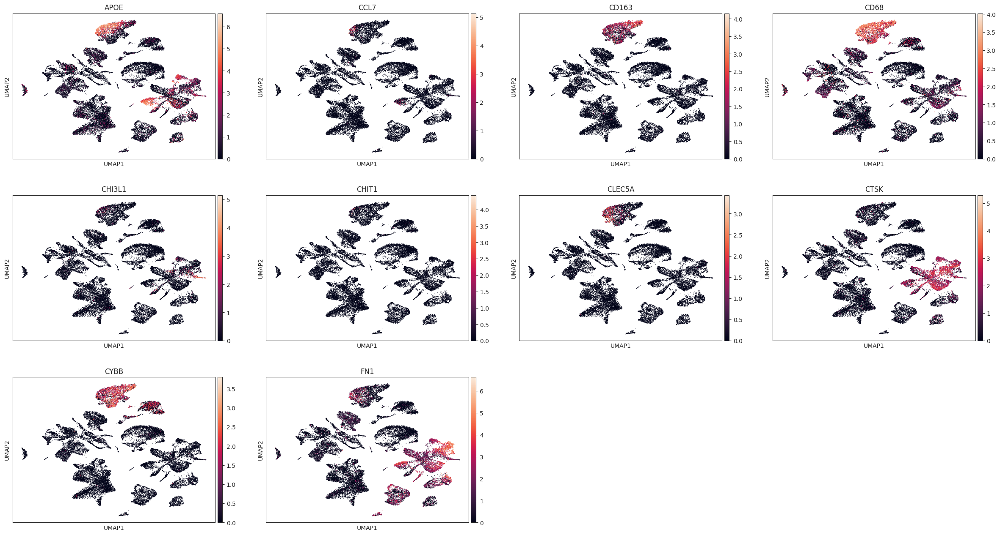

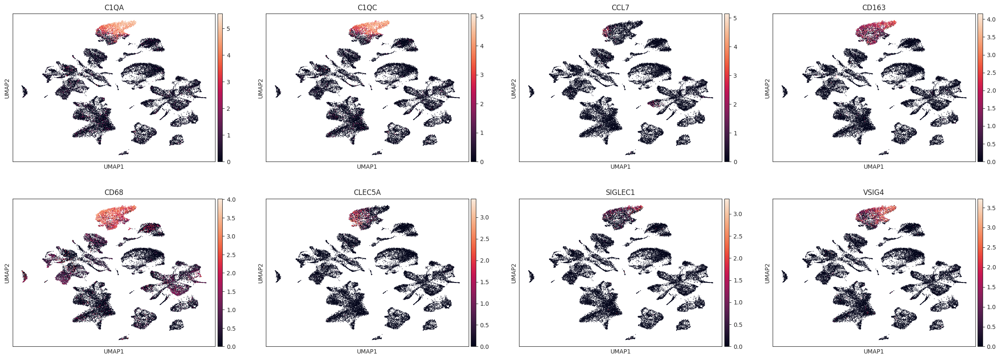

In [110]:
ax, ax1, scs[dataset], pvalues[dataset] = process_scrna_dataset(adata, geneset_of_interest, signature_name, geneset_of_interest_new, signature_name_new, dataset,
                          celltype_col='Cell_type', y_max=20, y_min=-1, palette=cells_p, save_orig='Macrophages_Lee_original_signature.png', save_tuned='Macrophages_Lee_tuned_signature.png')

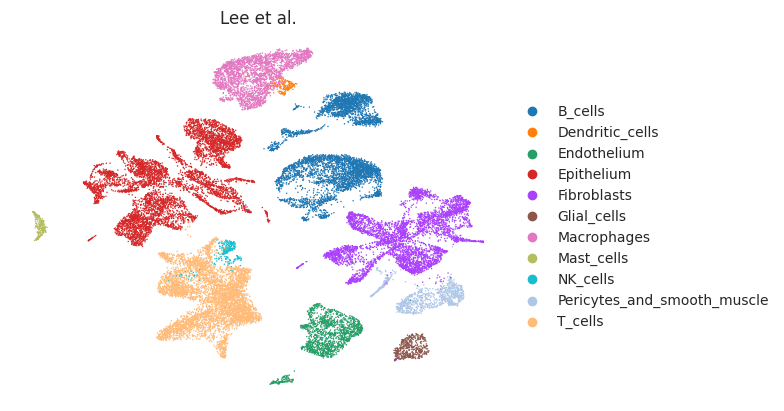

In [74]:
plt = sc.pl.umap(adata, color=['Cell_type'], frameon=False, title='Lee et al.', save='Macrophages_Lee_Cell_type.png')

Suppl figure 2C

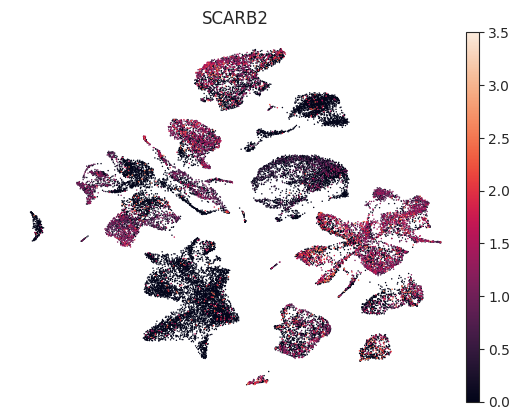

In [75]:
plt = sc.pl.umap(adata, color=['SCARB2'], frameon=False, title='SCARB2', save='Macrophages_Lee_bad_gene_SCARB2.png')

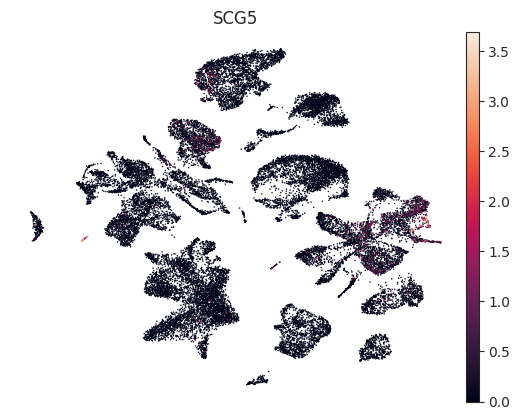

In [76]:
plt = sc.pl.umap(adata, color=['SCG5'], frameon=False, title='SCG5', save='Macrophages_Lee_bad_gene_SCG5.png')

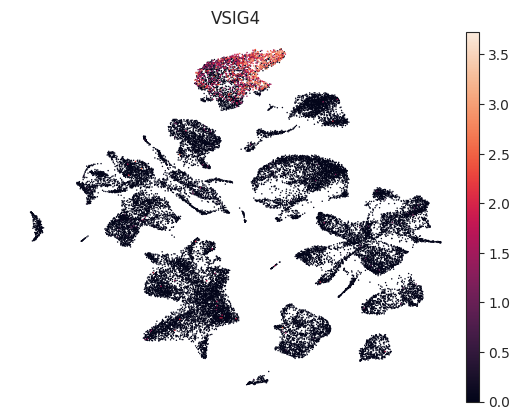

In [77]:
plt = sc.pl.umap(adata, color=['VSIG4'], frameon=False, title='VSIG4', save='Macrophages_Lee_good_gene_VSIG4.png')

### Pelka et al CRC

In [24]:
# Pelka CRC
adata = sc.read('/uftp/single_cell/annotations/Public_datasets/Ready/CAF_project/PMID_34450029_Pelka_et_al_CRC/PMID_34450029_all.h5ad')
dataset = 'Pelka'

In [25]:
adata.obs['Cell_type'] = adata.obs['clMidwayPr'].astype(str)
cells = adata.obs[(adata.obs['clMidwayPr'].isin(['Epi']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Epithelium'
cells = adata.obs[(adata.obs['clMidwayPr'].isin(['B', 'Plasma']))].index
adata.obs.loc[cells, 'Cell_type'] = 'B_cells'
cells = adata.obs[(adata.obs['clMidwayPr'].isin(['Mast']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Mast_cells'
cells = adata.obs[(adata.obs['clMidwayPr'].isin(['TCD4', 'TCD8', 'TZBTB16', 'Tgd', 'ILC']))].index
adata.obs.loc[cells, 'Cell_type'] = 'T_cells'
cells = adata.obs[(adata.obs['clMidwayPr'].isin(['DC']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Dendritic_cells'
cells = adata.obs[(adata.obs['clMidwayPr'].isin(['Granulo']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Granulocytes'
cells = adata.obs[(adata.obs['clMidwayPr'].isin(['Mono']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Monocytes'
cells = adata.obs[(adata.obs['clMidwayPr'].isin(['NK']))].index
adata.obs.loc[cells, 'Cell_type'] = 'NK_cells'
cells = adata.obs[(adata.obs['clMidwayPr'].isin(['Schwann']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Glial_cells'
cells = adata.obs[(adata.obs['clMidwayPr'].isin(['Fibro']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Fibroblasts'
cells = adata.obs[(adata.obs['clMidwayPr'].isin(['Endo']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Endothelium'
cells = adata.obs[(adata.obs['clMidwayPr'].isin(['Peri', 'SmoothMuscle']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Pericytes_and_smooth_muscle'
cells = adata.obs[(adata.obs['clMidwayPr'].isin(['Macro']))].index
adata.obs.loc[cells, 'Cell_type'] = 'Macrophages'
adata.obs.Cell_type.value_counts()

Epithelium                     82699
T_cells                        61639
B_cells                        59965
Macrophages                    18548
Monocytes                      12662
Endothelium                     6679
Dendritic_cells                 5344
Fibroblasts                     4391
Mast_cells                      3581
NK_cells                        3492
Pericytes_and_smooth_muscle     2003
Granulocytes                    1723
Glial_cells                      208
Name: Cell_type, dtype: int64

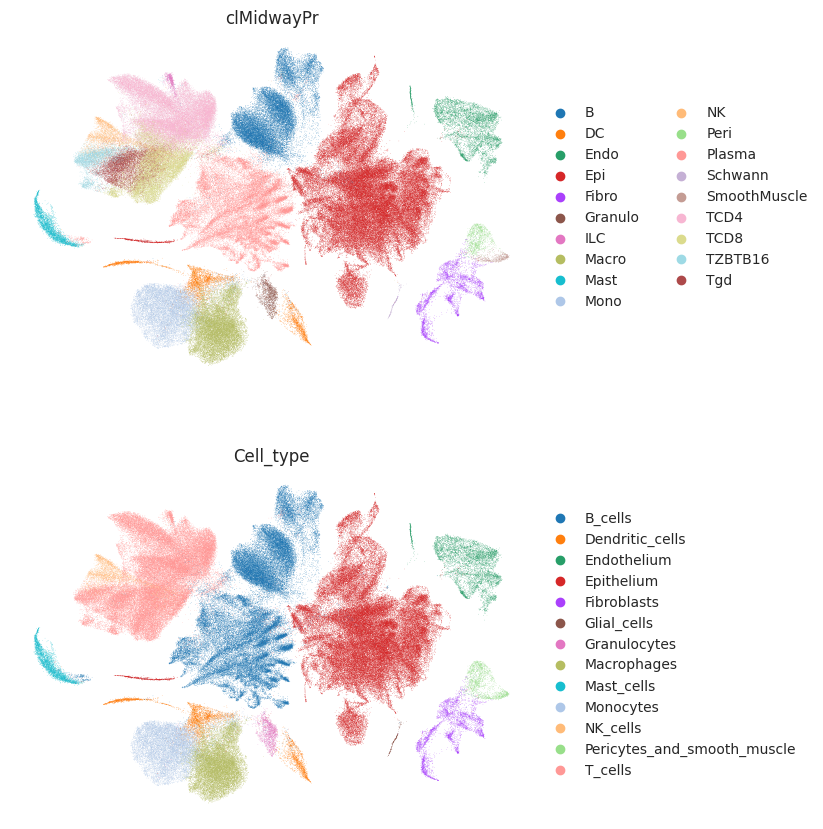

In [26]:
sc.pl.umap(adata, color=['clMidwayPr', 'Cell_type'], frameon=False, ncols=1)

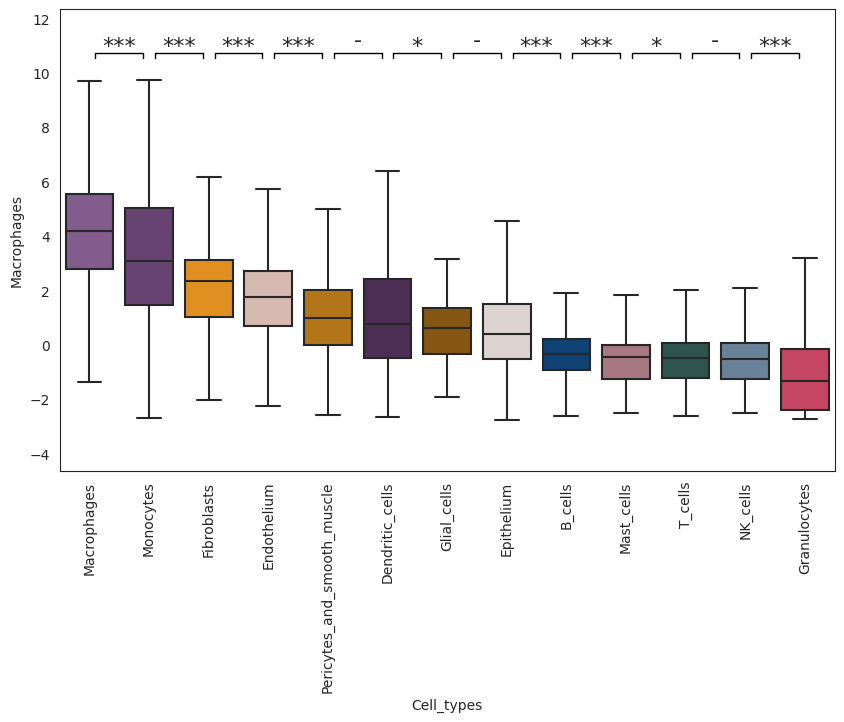

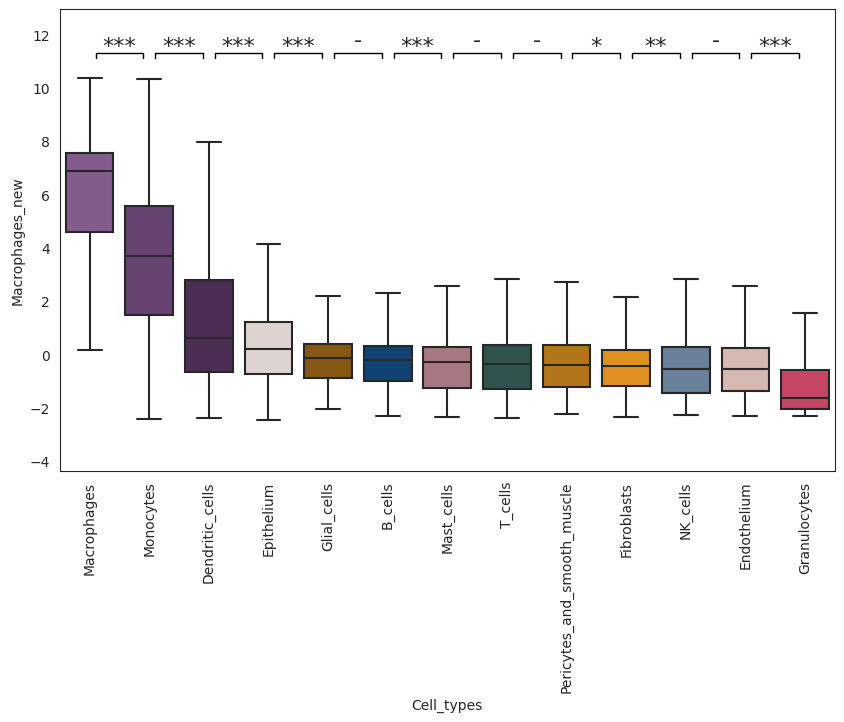

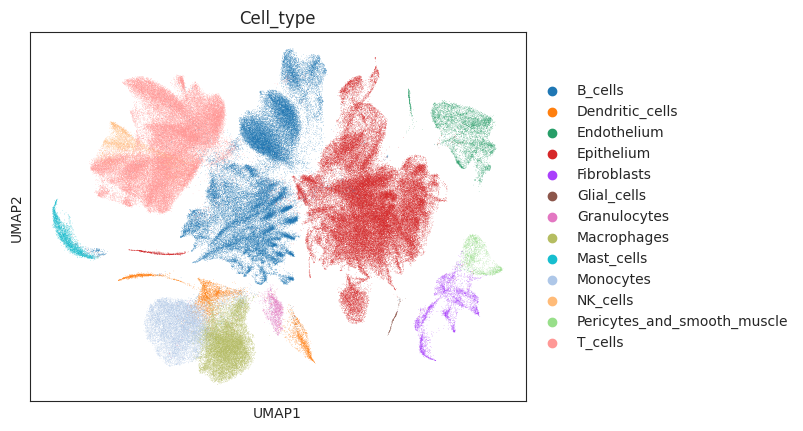

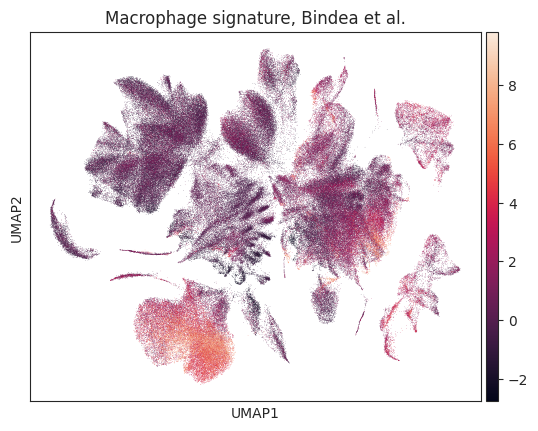

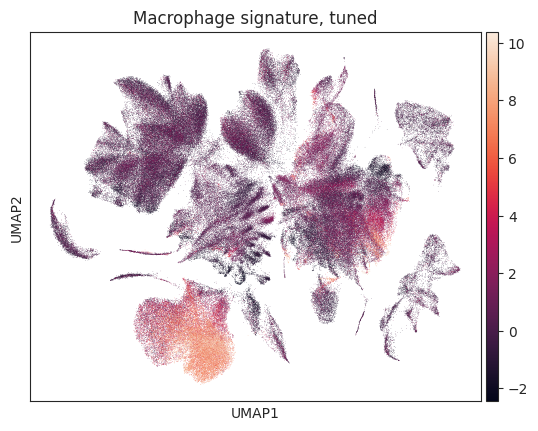

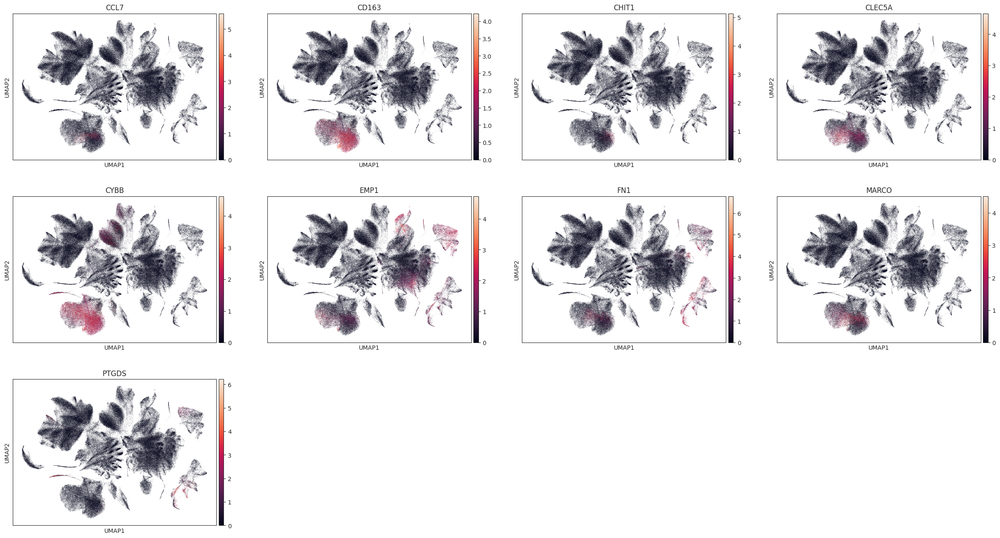

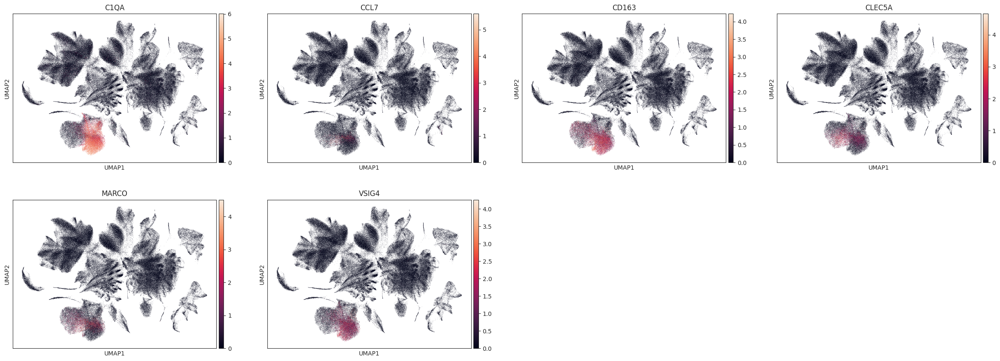

In [27]:
ax, ax1, scs[dataset], pvalues[dataset] = process_scrna_dataset(adata, geneset_of_interest, signature_name, geneset_of_interest_new, signature_name_new, dataset,
                          celltype_col='Cell_type', y_max=10.5, y_min=-3, palette=cells_p, save_orig=None, save_tuned=None)
plt.show()

## Dotplot

In [116]:
scs = pd.concat(scs.values(), axis=1)
sps_all = pd.concat(pvalues.values(), axis=1)
scs = scs.T[['Macrophages', 'Monocytes', 'Dendritic_cells', 'Mast_cells', 'NK_cells', 'T_cells', 'B_cells', 'Fibroblasts', 'Pericytes_and_smooth_muscle', 'Endothelium', 'Epithelium', 'Glial_cells', 'Granulocytes']].T
sps_all = sps_all.T[['Macrophages', 'Monocytes', 'Dendritic_cells', 'Mast_cells', 'NK_cells', 'T_cells', 'B_cells', 'Fibroblasts', 'Pericytes_and_smooth_muscle', 'Endothelium', 'Epithelium', 'Glial_cells', 'Granulocytes']].T

In [111]:
#sps_all = pd.read_csv('/uftp/users/msavchenko/data/Macrophages_pvalues_signature_comparison_all.tsv', sep='\t', index_col=0)
#scs = pd.read_csv('/uftp/users/msavchenko/data/Macrophages_median_all.tsv', sep='\t', index_col=0)
scs

,Macrophages_TIAtlas,Macrophages_new_TIAtlas,Macrophages_Puram,Macrophages_new_Puram,Macrophages_Lee,Macrophages_new_Lee,Macrophages_Pelka,Macrophages_new_Pelka,Macrophages_BG,Macrophages_new_BG
Macrophages,6.523917,27.687730,3.758968,8.446490,2.287679,11.606999,3.917335,3.931969,5.358298,17.582839
Monocytes,3.905459,15.807563,NaN,NaN,NaN,NaN,1.784088,1.897358,3.068035,10.399185
Dendritic_cells,2.952984,6.683484,-0.367407,0.311024,0.753761,0.306379,0.625149,0.739362,2.945985,11.975659
Mast_cells,0.009297,0.729962,0.055633,0.761894,-0.238308,-0.486154,-0.195798,-0.096831,0.482237,1.057533
NK_cells,-0.249912,-0.034040,NaN,NaN,-0.486311,-0.642618,-0.498148,-0.373084,-0.502509,0.058289
T_cells,-0.196360,-0.171459,-0.204432,0.647032,-0.508120,-0.615607,-0.440383,-0.273160,-0.251089,-0.021650
B_cells,0.377630,-0.405955,-0.150435,0.276816,-0.522824,0.061567,-0.337124,-0.198339,-0.083239,-0.156548
Fibroblasts,NaN,NaN,0.848476,0.324363,1.840938,-0.157052,1.502615,-0.133051,2.666115,-0.165141
Pericytes_and_smooth_muscle,NaN,NaN,0.079127,0.226463,0.373124,0.182025,0.135996,-0.225671,0.910945,0.008327
Endothelium,NaN,NaN,0.455167,-0.039723,-0.318312,0.150215,-0.471500,-0.348761,0.637953,0.072445


In [34]:
filepath = Path('/uftp/users/msavchenko/data/Macrophages_pvalues_signature_comparison_all.tsv')  
filepath.parent.mkdir(parents=True, exist_ok=True)  
sps_all.to_csv(filepath, sep='\t')

In [120]:
datasets = ['Nieto', 'Puram', 'Lee', 'Pelka', 'BG']

In [121]:
for dataset in datasets:
    scs[[f'{signature_name}_{dataset}', f'{signature_name_new}_{dataset}']] -= scs[[f'{signature_name}_{dataset}', f'{signature_name_new}_{dataset}']].min().min()
    scs[[f'{signature_name}_{dataset}', f'{signature_name_new}_{dataset}']] = scs[[f'{signature_name}_{dataset}', f'{signature_name_new}_{dataset}']]/scs[[f'{signature_name}_{dataset}', f'{signature_name_new}_{dataset}']].max().max()
scs

,Macrophages_BG,Macrophages_new_BG,Macrophages_Nieto,Macrophages_new_Nieto,Macrophages_Puram,Macrophages_new_Puram,Macrophages_Lee,Macrophages_new_Lee,Macrophages_Pelka,Macrophages_new_Pelka
Macrophages,0.531181,1.0,0.434049,1.0,0.476419,1.0,0.778626,1.0,0.996925,1.0
Monocytes,0.373332,0.631697,0.276066,0.577123,NaN,NaN,NaN,NaN,0.548731,0.572529
Dendritic_cells,0.364921,0.712522,0.2186,0.25235,0.187265,0.106209,0.528116,0.589223,0.305238,0.329234
Mast_cells,0.195115,0.152753,0.040994,0.040433,0.216909,0.155743,0.262809,0.044619,0.132757,0.15355
NK_cells,0.127245,0.101523,0.025355,0.013238,NaN,NaN,0.093546,0.000366,0.069233,0.095509
T_cells,0.144574,0.097424,0.028586,0.008347,0.198685,0.143124,0.085537,0.0,0.08137,0.116503
B_cells,0.156142,0.090508,0.063217,0.0,0.202469,0.102451,0.087471,0.055302,0.103064,0.132223
Fibroblasts,0.345632,0.090067,NaN,NaN,0.272467,0.107675,0.599182,0.04966,0.489593,0.14594
Pericytes_and_smooth_muscle,0.224663,0.098961,NaN,NaN,0.218556,0.096919,0.373461,0.061695,0.202467,0.126481
Endothelium,0.205848,0.102248,NaN,NaN,0.244906,0.067675,0.306556,0.05479,0.074832,0.10062


Figure 4D

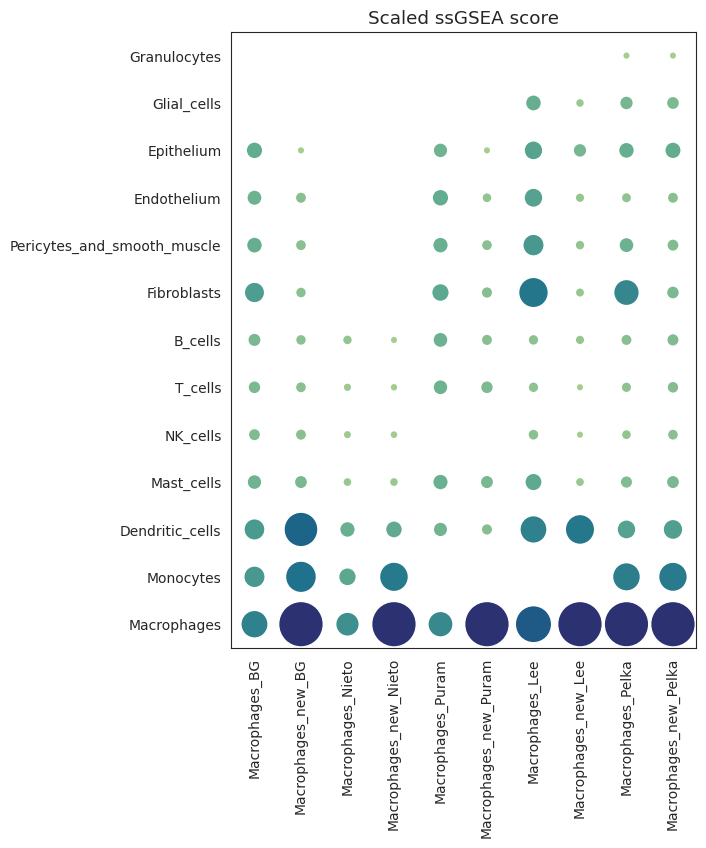

In [136]:
# 0.2-1.2 color=value
sps = scs.astype('float')

N = scs.shape[0]
M = scs.shape[1]
x, y = np.meshgrid(np.arange(M), np.arange(N))

# делаю кружки только определенного размера (задаю на этот счет трешхолды)
corrs = pd.Series(np.array(scs).flatten())
corrs = (corrs+0.2)*0.4
#делаю особый колормап чтобы цвет отличал значимое от незначимого
minpvalue = 0.001
mediumpvalue = 0.01
maxpvalue = 0.05
max_correlation = 1
number_of_colors = int(max_correlation/minpvalue)

minpvalue_pos = 0
mediumpvalue_pos = int(round(mediumpvalue/minpvalue-1))
maxpvalue_pos = int(round(maxpvalue/minpvalue-1))

from matplotlib import colors
pvalcolor_min =  sns.color_palette("coolwarm_r", n_colors=9)[8]
pvalcolor_med =  sns.color_palette("coolwarm_r", n_colors=9)[4]

#or you can pick it
#https://htmlcolors.com/rgba-color pick colors here, except the last 1 (it is opacity)
# pvalcolor_min =  list(pd.Series([156, 43, 255])/255)+[1]
# pvalcolor_med =  list(pd.Series([50, 36, 187])/255)+[1]
# pvalcolor_max =  list(pd.Series([194, 135, 192])/255)+[1]

othercolor = sns.color_palette("coolwarm_r", n_colors=9)[0]

from matplotlib.colors import ListedColormap
#newcmap = ListedColormap(np.array([pvalcolor_min]+[pvalcolor_med]*mediumpvalue_pos+[pvalcolor_max]*(maxpvalue_pos-(mediumpvalue_pos+1))+[othercolor]*(number_of_colors-maxpvalue_pos)))

#собственно, плот.  можно регулировать размер фигуры, чтобы сделать кружки более ровными (зависит от количества строк и колонок)
sns.set_style("white")
fig, ax = plt.subplots(figsize=(6, 8))
matplotlib.rcParams.update({'font.size': 11})

circles = [plt.Circle((j,i), radius=r) for r, j, i in zip(np.array(corrs).flat, x.flat, y.flat)]

col = PatchCollection(circles,array=np.array(sps).flatten(), cmap=sns.color_palette("crest", as_cmap=True))
ax.add_collection(col)

ax.set(xticks=np.arange(M), yticks=np.arange(N),
       xticklabels=scs.columns, yticklabels=scs.index)
ax.set_xticks(np.arange(M+1)-0.5, minor=True)
ax.set_yticks(np.arange(N+1)-0.5, minor=True)
#ax.grid()
ax.set_xticklabels(scs.columns, rotation=90)

plt.title('Scaled ssGSEA score')

#for r, j, i, p in zip(np.array(scs).flatten(), x.flat, y.flat,np.array(sps).flatten()):

#    if p<0.05:
#        label = ax.annotate(str(round(r,2)), xy=(j, i-0.03), fontsize=9, ha="center", color='white')
plt.rcParams['svg.fonttype'] = 'none'
plt.savefig("/uftp/users/msavchenko/figures/Macrophages_signature_circle_plot_02_12_value_color.svg", format="svg")
plt.show()

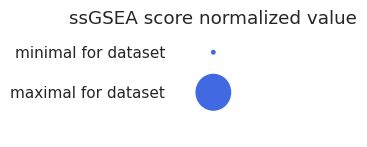

In [137]:
scs1 = pd.DataFrame(columns=['ssGSEA score normalized value'], index=['maximal for dataset', 'minimal for dataset'])
scs1['ssGSEA score normalized value']['minimal for dataset'] = 0.0
scs1['ssGSEA score normalized value']['maximal for dataset'] = 1.0
sps1 = pd.DataFrame(columns=['ssGSEA score normalized value'], index=['maximal for dataset', 'minimal for dataset'])
sps1['ssGSEA score normalized value']['minimal for dataset'] = 0.001
sps1['ssGSEA score normalized value']['maximal for dataset'] = 0.001
sps1 = sps1.astype(float)
N = scs1.shape[0]
M = scs1.shape[1]
x, y = np.meshgrid(np.arange(M), np.arange(N))
corrs = pd.Series(np.array(scs1).flatten())
corrs = (corrs+0.2)*0.4
minpvalue = 0.001
mediumpvalue = 0.01
maxpvalue = 0.05
max_correlation = 1
number_of_colors = int(max_correlation/minpvalue)

minpvalue_pos = 0
mediumpvalue_pos = int(round(mediumpvalue/minpvalue-1))
maxpvalue_pos = int(round(maxpvalue/minpvalue-1))

from matplotlib import colors
pvalcolor_min =  list(colors.to_rgba('royalblue'))
pvalcolor_med =  list(colors.to_rgba('mediumpurple'))
pvalcolor_max =  list(colors.to_rgba('seagreen'))
#or you can pick it
#https://htmlcolors.com/rgba-color pick colors here, except the last 1 (it is opacity)
# pvalcolor_min =  list(pd.Series([156, 43, 255])/255)+[1]
# pvalcolor_med =  list(pd.Series([50, 36, 187])/255)+[1]
# pvalcolor_max =  list(pd.Series([194, 135, 192])/255)+[1]

othercolor = list(colors.to_rgba('lightgray'))
from matplotlib.colors import ListedColormap
newcmap = ListedColormap(np.array([pvalcolor_min]+[pvalcolor_med]*mediumpvalue_pos+[pvalcolor_max]*(maxpvalue_pos-(mediumpvalue_pos+1))+[othercolor]*(number_of_colors-maxpvalue_pos)))

sns.set_style("white")
fig, ax = plt.subplots(figsize=(1, 1.04))
matplotlib.rcParams.update({'font.size': 11})

circles = [plt.Circle((j,i), radius=r) for r, j, i in zip(np.array(corrs).flat, x.flat, y.flat)]

col = PatchCollection(circles,array=np.array(sps1).flatten(), cmap=newcmap)
ax.add_collection(col)

ax.set(xticks=np.arange(M), yticks=np.arange(N),
       yticklabels=scs1.index)
ax.set_xticks(np.arange(M+1)-1, minor=True)
ax.set_yticks(np.arange(N+1)-0.5, minor=True)
#ax.grid()
ax.set_xticklabels(' ')

plt.title('ssGSEA score normalized value')

#for r, j, i, p in zip(np.array(sps1).flatten(), x.flat, y.flat,np.array(scs1).flatten()):

#    if p<0.05:
#        label = ax.annotate(str(round(r,2)), xy=(j, i-0.07), fontsize=9, ha="center", color='white')
plt.rcParams['svg.fonttype'] = 'none'
sns.despine(left=True, bottom=True)
plt.savefig("/uftp/users/msavchenko/figures/Macrophages_signature_circle_plot_02_12_size_legend.svg", format="svg")


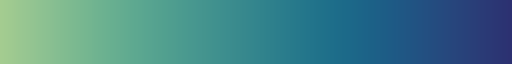

In [138]:
sns.color_palette("crest", as_cmap=True)

In [140]:
sps = pd.DataFrame(index=scs.index, columns=scs.columns)
for dataset in datasets:
    pvalues_greater = sps_all[f'{signature_name_new}_{dataset}']
    pvalues_less = sps_all[f'{signature_name}_{dataset}']
    for i in sps.index:
        if pvalues_greater[i]<0.05:
            sps[f'{signature_name_new}_{dataset}'][i] = 1
            sps[f'{signature_name}_{dataset}'][i] = -1
        elif pvalues_less[i]<0.05:
            sps[f'{signature_name_new}_{dataset}'][i] = -1
            sps[f'{signature_name}_{dataset}'][i] = 1
        else:
            sps[f'{signature_name_new}_{dataset}'][i] = 0
            sps[f'{signature_name}_{dataset}'][i] = 0
sps = sps.astype('float')        
sps

,Macrophages_BG,Macrophages_new_BG,Macrophages_Nieto,Macrophages_new_Nieto,Macrophages_Puram,Macrophages_new_Puram,Macrophages_Lee,Macrophages_new_Lee,Macrophages_Pelka,Macrophages_new_Pelka
Macrophages,-1.0,1.0,-1.0,1.0,-1.0,1.0,-1.0,1.0,-1.0,1.0
Monocytes,-1.0,1.0,-1.0,1.0,0.0,0.0,0.0,0.0,1.0,-1.0
Dendritic_cells,-1.0,1.0,-1.0,1.0,1.0,-1.0,-1.0,1.0,1.0,-1.0
Mast_cells,1.0,-1.0,0.0,0.0,1.0,-1.0,1.0,-1.0,1.0,-1.0
NK_cells,1.0,-1.0,1.0,-1.0,0.0,0.0,1.0,-1.0,1.0,-1.0
T_cells,1.0,-1.0,1.0,-1.0,1.0,-1.0,1.0,-1.0,1.0,-1.0
B_cells,1.0,-1.0,1.0,-1.0,1.0,-1.0,1.0,-1.0,1.0,-1.0
Fibroblasts,1.0,-1.0,0.0,0.0,1.0,-1.0,1.0,-1.0,1.0,-1.0
Pericytes_and_smooth_muscle,1.0,-1.0,0.0,0.0,1.0,-1.0,1.0,-1.0,1.0,-1.0
Endothelium,1.0,-1.0,0.0,0.0,1.0,-1.0,1.0,-1.0,1.0,-1.0


In [141]:
scs = scs.T
scs['new_index'] = ['Bindea et al.', 'Tuned', 'Bindea et al.', 'Tuned', 'Bindea et al.', 'Tuned', 'Bindea et al.', 'Tuned', 'Bindea et al.', 'Tuned']
scs.index = scs.new_index
scs = scs[['Macrophages', 'Monocytes', 'Dendritic_cells', 'Mast_cells', 'NK_cells',
       'T_cells', 'B_cells', 'Fibroblasts', 'Pericytes_and_smooth_muscle',
       'Endothelium', 'Epithelium', 'Glial_cells', 'Granulocytes']]
scs = scs.T
scs

new_index,Bindea et al.,Tuned,Bindea et al.,Tuned,Bindea et al.,Tuned,Bindea et al.,Tuned,Bindea et al.,Tuned
Macrophages,0.531181,1.0,0.434049,1.0,0.476419,1.0,0.778626,1.0,0.996925,1.0
Monocytes,0.373332,0.631697,0.276066,0.577123,NaN,NaN,NaN,NaN,0.548731,0.572529
Dendritic_cells,0.364921,0.712522,0.2186,0.25235,0.187265,0.106209,0.528116,0.589223,0.305238,0.329234
Mast_cells,0.195115,0.152753,0.040994,0.040433,0.216909,0.155743,0.262809,0.044619,0.132757,0.15355
NK_cells,0.127245,0.101523,0.025355,0.013238,NaN,NaN,0.093546,0.000366,0.069233,0.095509
T_cells,0.144574,0.097424,0.028586,0.008347,0.198685,0.143124,0.085537,0.0,0.08137,0.116503
B_cells,0.156142,0.090508,0.063217,0.0,0.202469,0.102451,0.087471,0.055302,0.103064,0.132223
Fibroblasts,0.345632,0.090067,NaN,NaN,0.272467,0.107675,0.599182,0.04966,0.489593,0.14594
Pericytes_and_smooth_muscle,0.224663,0.098961,NaN,NaN,0.218556,0.096919,0.373461,0.061695,0.202467,0.126481
Endothelium,0.205848,0.102248,NaN,NaN,0.244906,0.067675,0.306556,0.05479,0.074832,0.10062


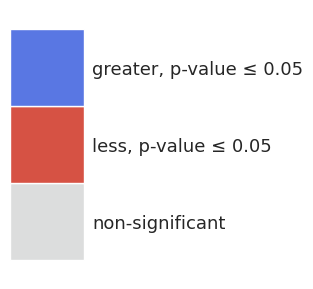

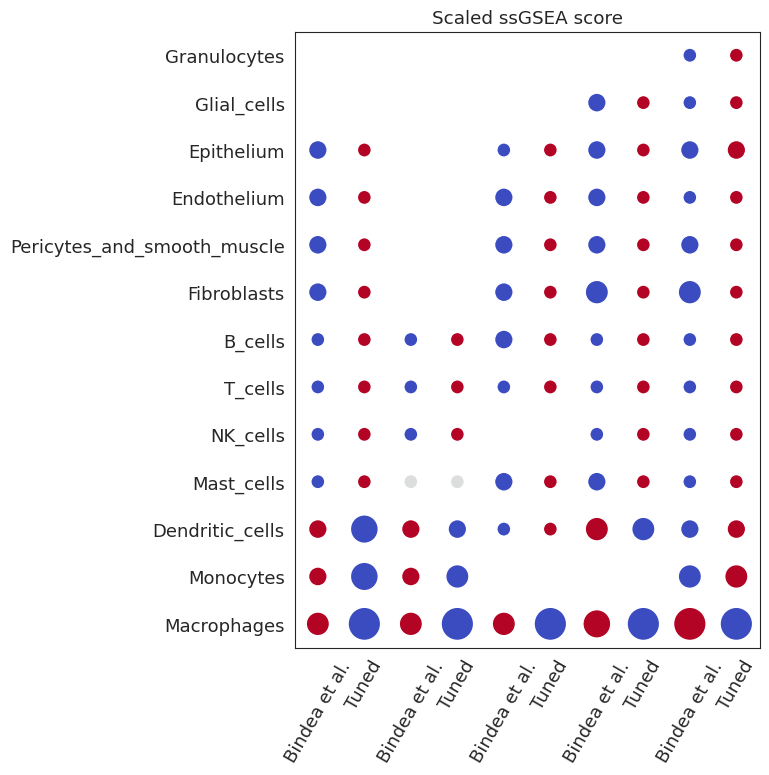

In [142]:
# quintiles

N = scs.shape[0]
M = scs.shape[1]
x, y = np.meshgrid(np.arange(M), np.arange(N))

# делаю кружки только определенного размера (задаю на этот счет трешхолды)

corrs = pd.Series(np.array(scs).flatten())
#corrs -= corrs.min()
#corrs = corrs/corrs.max()
for i in corrs.index:
    if corrs.loc[i]<=0.2:
        corrs.loc[i]  = 0.05
    elif corrs.loc[i]>0.2 and corrs.loc[i]<=0.4:
        corrs.loc[i]= 0.1
    elif corrs.loc[i]>0.4 and corrs.loc[i]<=0.6:
        corrs.loc[i]= 0.15
    elif corrs.loc[i]>0.6 and corrs.loc[i]<=0.8:
        corrs.loc[i]= 0.2
    elif corrs.loc[i]>0.8:
        corrs.loc[i]= 0.25
corrs = corrs+0.1
#делаю особый колормап чтобы цвет отличал значимое от незначимого
minpvalue = 0.001
mediumpvalue = 0.01
maxpvalue = 0.05
max_correlation = 1
number_of_colors = int(max_correlation/minpvalue)

minpvalue_pos = 0
mediumpvalue_pos = int(round(mediumpvalue/minpvalue-1))
maxpvalue_pos = int(round(maxpvalue/minpvalue-1))

from matplotlib import colors
pvalcolor_min =  sns.color_palette("coolwarm_r", n_colors=9)[8]
pvalcolor_med =  sns.color_palette("coolwarm_r", n_colors=9)[4]

#or you can pick it
#https://htmlcolors.com/rgba-color pick colors here, except the last 1 (it is opacity)
# pvalcolor_min =  list(pd.Series([156, 43, 255])/255)+[1]
# pvalcolor_med =  list(pd.Series([50, 36, 187])/255)+[1]
# pvalcolor_max =  list(pd.Series([194, 135, 192])/255)+[1]

othercolor = sns.color_palette("coolwarm_r", n_colors=9)[0]

from matplotlib.colors import ListedColormap
#newcmap = ListedColormap(np.array([pvalcolor_min]+[pvalcolor_med]*mediumpvalue_pos+[pvalcolor_max]*(maxpvalue_pos-(mediumpvalue_pos+1))+[othercolor]*(number_of_colors-maxpvalue_pos)))
fig, ax = plt.subplots(figsize=(1, 3.5))
matplotlib.rcParams.update({'font.size': 13})
patch_plot({'greater, p-value ≤ 0.05':pvalcolor_min,
           'non-significant':pvalcolor_med,
           'less, p-value ≤ 0.05':othercolor}, ax=ax)
plt.rcParams['svg.fonttype'] = 'none'
#plt.savefig("/home/msavchenko/data/Macrophages_signature_circle_plot_pvalue_legend.svg", format="svg")
plt.show()
plt.close()

#собственно, плот.  можно регулировать размер фигуры, чтобы сделать кружки более ровными (зависит от количества строк и колонок)
sns.set_style("white")
fig, ax = plt.subplots(figsize=(6, 8))
matplotlib.rcParams.update({'font.size': 11})

circles = [plt.Circle((j,i), radius=r) for r, j, i in zip(np.array(corrs).flat, x.flat, y.flat)]

col = PatchCollection(circles,array=np.array(sps).flatten(), cmap=sns.color_palette("coolwarm_r", as_cmap=True))
ax.add_collection(col)

ax.set(xticks=np.arange(M), yticks=np.arange(N),
       xticklabels=scs.columns, yticklabels=scs.index)
ax.set_xticks(np.arange(M+1)-0.5, minor=True)
ax.set_yticks(np.arange(N+1)-0.5, minor=True)
#ax.grid()
ax.set_xticklabels(scs.columns, rotation=60)

plt.title('Scaled ssGSEA score')

#for r, j, i, p in zip(np.array(scs).flatten(), x.flat, y.flat,np.array(sps).flatten()):

#    if p<0.05:
#        label = ax.annotate(str(round(r,2)), xy=(j, i-0.03), fontsize=9, ha="center", color='white')
plt.rcParams['svg.fonttype'] = 'none'
#plt.savefig("/uftp/users/msavchenko/data/Macrophages_signature_circle_plot_quintiles.svg", format="svg")
plt.show()

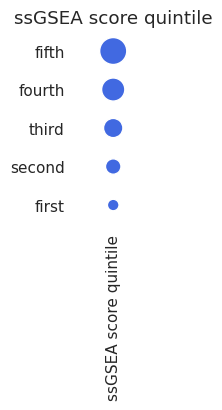

In [143]:
scs1 = pd.DataFrame(columns=['ssGSEA score quintile'], index=['first', 'second', 'third', 'fourth', 'fifth'])
scs1['ssGSEA score quintile']['first'] = 0.1
scs1['ssGSEA score quintile']['second'] = 0.3
scs1['ssGSEA score quintile']['third'] = 0.5
scs1['ssGSEA score quintile']['fourth'] = 0.7
scs1['ssGSEA score quintile']['fifth'] = 0.9
sps1 = pd.DataFrame(columns=['ssGSEA score quintile'], index=['first', 'second', 'third', 'fourth', 'fifth'])
sps1['ssGSEA score quintile']['first'] = 0.001
sps1['ssGSEA score quintile']['second'] = 0.001
sps1['ssGSEA score quintile']['third'] = 0.001
sps1['ssGSEA score quintile']['fourth'] = 0.001
sps1['ssGSEA score quintile']['fifth'] = 0.001
sps1 = sps1.astype(float)
N = scs1.shape[0]
M = scs1.shape[1]
x, y = np.meshgrid(np.arange(M), np.arange(N))
corrs = pd.Series(np.array(scs1).flatten())
for i in corrs.index:
    if corrs.loc[i]<=0.2:
        corrs.loc[i]  = 0.05
    elif corrs.loc[i]>0.2 and corrs.loc[i]<=0.4:
        corrs.loc[i]= 0.1
    elif corrs.loc[i]>0.4 and corrs.loc[i]<=0.6:
        corrs.loc[i]= 0.15
    elif corrs.loc[i]>0.6 and corrs.loc[i]<=0.8:
        corrs.loc[i]= 0.2
    elif corrs.loc[i]>0.8:
        corrs.loc[i]= 0.25
corrs = corrs+0.1
minpvalue = 0.001
mediumpvalue = 0.01
maxpvalue = 0.05
max_correlation = 1
number_of_colors = int(max_correlation/minpvalue)

minpvalue_pos = 0
mediumpvalue_pos = int(round(mediumpvalue/minpvalue-1))
maxpvalue_pos = int(round(maxpvalue/minpvalue-1))

from matplotlib import colors
pvalcolor_min =  list(colors.to_rgba('royalblue'))
pvalcolor_med =  list(colors.to_rgba('mediumpurple'))
pvalcolor_max =  list(colors.to_rgba('seagreen'))
#or you can pick it
#https://htmlcolors.com/rgba-color pick colors here, except the last 1 (it is opacity)
# pvalcolor_min =  list(pd.Series([156, 43, 255])/255)+[1]
# pvalcolor_med =  list(pd.Series([50, 36, 187])/255)+[1]
# pvalcolor_max =  list(pd.Series([194, 135, 192])/255)+[1]

othercolor = list(colors.to_rgba('lightgray'))
from matplotlib.colors import ListedColormap
newcmap = ListedColormap(np.array([pvalcolor_min]+[pvalcolor_med]*mediumpvalue_pos+[pvalcolor_max]*(maxpvalue_pos-(mediumpvalue_pos+1))+[othercolor]*(number_of_colors-maxpvalue_pos)))

sns.set_style("white")
fig, ax = plt.subplots(figsize=(1, 2.5))
matplotlib.rcParams.update({'font.size': 11})

circles = [plt.Circle((j,i), radius=r) for r, j, i in zip(np.array(corrs).flat, x.flat, y.flat)]

col = PatchCollection(circles,array=np.array(sps1).flatten(), cmap=newcmap)
ax.add_collection(col)

ax.set(xticks=np.arange(M), yticks=np.arange(N),
       yticklabels=scs1.index)
ax.set_xticks(np.arange(M+1)-1, minor=True)
ax.set_yticks(np.arange(N+1)-0.5, minor=True)
#ax.grid()
ax.set_xticklabels(scs1.columns, rotation=90)

plt.title('ssGSEA score quintile')

#for r, j, i, p in zip(np.array(sps1).flatten(), x.flat, y.flat,np.array(scs1).flatten()):

#    if p<0.05:
#        label = ax.annotate(str(round(r,2)), xy=(j, i-0.07), fontsize=9, ha="center", color='white')
plt.rcParams['svg.fonttype'] = 'none'
sns.despine(left=True, bottom=True)
#plt.savefig("/uftp/users/msavchenko/data/Macrophages_signature_circle_plot_qiuntiles_legend.svg", format="svg")
plt.show()